In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp

# Présentation du projet

Projet du cours d'Introduction au Machine Learning pour l'Image (IMLI)<br>
Promo : IMAGE 2025<br>
Enseignants : Guillaume Tochon & Joseph Chazalon

## Chargement et présentation des données

Les données qui sont mises à votre disposition pour ce projet sont celles du [_IEEE GRSS Data Fusion Contest 2013_](http://www.classic.grss-ieee.org/community/technical-committees/data-fusion/2013-ieee-grss-data-fusion-contest/). Le Data Fusion Contest de l'IEEE GRSS (Geoscience and Remote Sensing Society) est un challenge organisé chaque année par les membres du chapitre GRSS de l'association IEEE, qui est ouvert à tout chercheur, doctorant, étudiant, etc., et qui met en oeuvre des problématiques de fusion d'information (multi-capteurs, multi-dates, multi-sites, etc.) pour des applications en télédétection (imagerie satellitaire).

Les données du projet, présentées ci-dessous, ont été acquises au dessus de l'université de Houston en 2012, et se composent d'une image hyperpsectale de 144 bandes couvrant la portion $380-1050~$nm du spectre éléctromagnétique, et d'une image LiDAR. Les deux images sont à la même résolution spatiale de 2.5 m/pixel, et sont co-registrées (chaque pixel de l'une couvre exactement la même surface au sol que le pixel correspondant de l'autre image).

### Téléchargement et extraction des données

In [2]:
%%bash
if [ -d "data" ]; then
    echo "Le dossier data existe déjà"
else
    mkdir -p "data"
    wget -q "https://www.lrde.epita.fr/~gtochon/IML/data.zip" -P "data"
    unzip -q "data/*.zip" -d "data"
    rm "data/"*.zip*
fi

Le dossier data existe déjà


### Image LIDAR ([plus d'infos ici](https://fr.wikipedia.org/wiki/Lidar))

Une image acquise par un capteur LiDAR fournit un modèle d'élévation de terrain (DSM, pour _digital surface model_). La scène est illuminée par un laser, et le capteur mesure le délai nécessaire à l'écho laser pour revenir depuis la cible. Connaissant la vitesse de déplacement du laser (vitesse de la lumière) et le temps nécessaire au laser pour faire l'aller/retour jusqu'à la scène, on peut en déduire facilement la distance. Lorsque le capteur LiDAR est embarqué sur un avion, la connaissance supplémentaire de l'altitude de vol de l'avion permet d'en déduire au final la hauteur du terrain (normalisée par rapport à une hauteur 0 fixée de manière arbitraire) : plus la valeur d'un pixel est élevée dans l'image LiDAR, plus la zone au sol correpondante est haute.

In [3]:
lidar = np.load("data/lidar.npy")
print(
    "L'image LiDAR est composée de %d lignes et %d colonnes " % (lidar.shape)
    + "au format %s" % lidar.dtype
)

L'image LiDAR est composée de 349 lignes et 1905 colonnes au format float32


#### Visualisation du LiDAR

In [4]:
print(
    "Valeur min = %1.3f et valeur max = %1.3f dans l'image LiDAR"
    % (lidar.min(), lidar.max())
)

Valeur min = 4.420 et valeur max = 70.852 dans l'image LiDAR


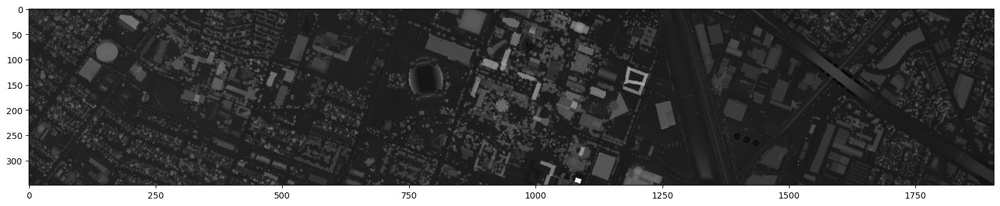

In [5]:
plt.figure(figsize=(20, 5))
plt.imshow(lidar, cmap="gray")
plt.show()

### Image hyperspectrale ([plus d'infos ici](https://fr.wikipedia.org/wiki/Imagerie_hyperspectrale))

Les images hyperspectrales sont des "extensions" des images RGB traditionnelles dans le sens où elles n'ont plus 3 canaux, mais des centaines (voire des milliers). 
Un capteur hyperspectral échantillonne finement le spectre électromagnétique en collectant la quantité de lumière reçue dans de fines bandes de longueur d'onde (typiquement, une bande spectrale correspond a une largeur de quelques nanomètres). Au final, on obtient un cube de données avec $N$ canaux, et un pixel $\mathbf{x}$ n'est plus un triplet $\mathbf{x} = [x_R, x_G, x_B]$ comme pour une image RGB, mais un $N$-uplet $\mathbf{x} = [x_1,\dots,x_N] \in \mathbb{R}^N$ où chaque valeur $x_i$ correspond à la quantité de lumière qui a été reçue dans la $i$ème bande. Comme chaque bande est associée à une longueur d'onde particulière dans le spectre électromagnétique, tracer $\mathbf{x}$ en fonction de $i$ donne un _spectre de réflectance,_ en d'autres termes, comment la lumière qui atteint le capteur a interagi avec la matière dans la scène imagée. Comme deux matériaux différents (par exemple la végétation et le bitume) n'interagissent pas de la même manière avec la lumière, une image hyperspectrale permet d'identifier les composants macroscopiques (végétation, terre, métal, béton, eau, etc) présents dans la scène imagée. Les capteurs hyperspectraux sont largement utilisés dans le domaine de l'imagerie satellitaire (embarqués dans des avions et des satellites) à des fins d'observation de la Terre.

In [6]:
hsi_raw = np.load("data/hyperspectral.npy")
print(
    "L'image hyperspectrale est composée de %d lignes, %d colonnes et %d bandes "
    % (hsi_raw.shape)
    + "au format %s" % hsi_raw.dtype
)

L'image hyperspectrale est composée de 349 lignes, 1905 colonnes et 144 bandes au format uint16


#### Visualisation de l'image hyperspectrale

In [7]:
print(
    "Valeur min = %d et valeur max = %d dans l'image hyperspectrale"
    % (hsi_raw.min(), hsi_raw.max())
)

Valeur min = 0 et valeur max = 65517 dans l'image hyperspectrale


Une image hyperspectrale étant composée de centaines (voir milliers) de bandes, sa visualisation n'est pas directe : on ne peut pas demander à une routine de visualisation d'afficher telle quelle une image hyperspectrale. Il faut au préalable en extraire une version RGB, en sélectionnant 3 bandes spectrales (c'est-à-dire, 3 tranches du cube de données) dont les longueurs d'ondes correspondent à celles du rouge, du vert et du bleu.

Ici, l'intervalle de longueur d'ondes $380-1050~$nm est subdivisé en 144 bandes spectrales, et prenant comme longueurs d'ondes de référence 465 nm pour le bleu, 532 nm pour le vert et 630 nm pour le rouge, on peut calculer les bandes RGB suivantes : R = 54$^e$ bande, G = 32$^e$ bande et B = 18$^e$ bande.

In [8]:
rgb_bands = [54, 32, 18]
hsi_rgb = hsi_raw[:, :, rgb_bands]
hsi_rgb = (
    hsi_rgb / hsi_rgb.max()
)  # normalisation des valeurs dans [0,1] pour l'affichage

In [9]:
# Don't mind me, I'm just here to pimp a little bit the RGB image
pmin, pmax = np.percentile(hsi_rgb, (1, 95), axis=(0, 1))
hsi_rgb_pimped = hsi_rgb.copy()
for i in range(pmin.size):
    hsi_rgb_pimped[:, :, i] = (hsi_rgb[:, :, i] - pmin[i]) / (pmax[i] - pmin[i])
hsi_rgb_pimped[hsi_rgb_pimped < 0] = 0
hsi_rgb_pimped[hsi_rgb_pimped > 1] = 1

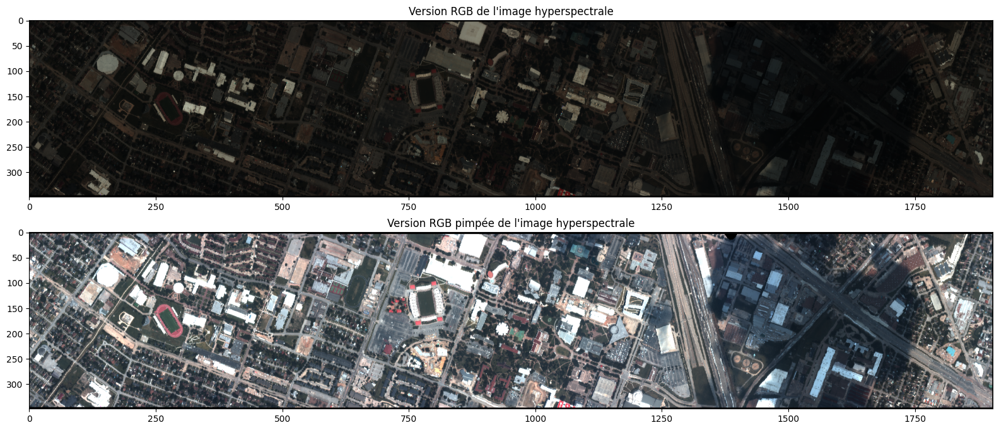

In [10]:
plt.figure(figsize=(20, 8))
plt.subplot(211)
plt.title("Version RGB de l'image hyperspectrale")
plt.imshow(hsi_rgb)
plt.subplot(212)
plt.title("Version RGB pimpée de l'image hyperspectrale")
plt.imshow(hsi_rgb_pimped)
plt.show()

La scène est donc composée majoritairement de structures urbaines (maisons, bâtiments, routes, etc). On peut voir également des structures sportives (stade, piste de running, terrains de tennis). La partie droite de l'image est également assombrie par la présence d'un nuage (non discernable dans le LiDAR, qui est insensible aux artefacts d'illumations).

Pour facilier l'analyse visuelle de la scène, on peut la subdiviser en 3 sous-images correspondant à la partie gauche, à la partie centrale et à la partie droite de la scène. On peut remarquer en particulier une bande noire sur le pourtour de l'image hyperspectrale.

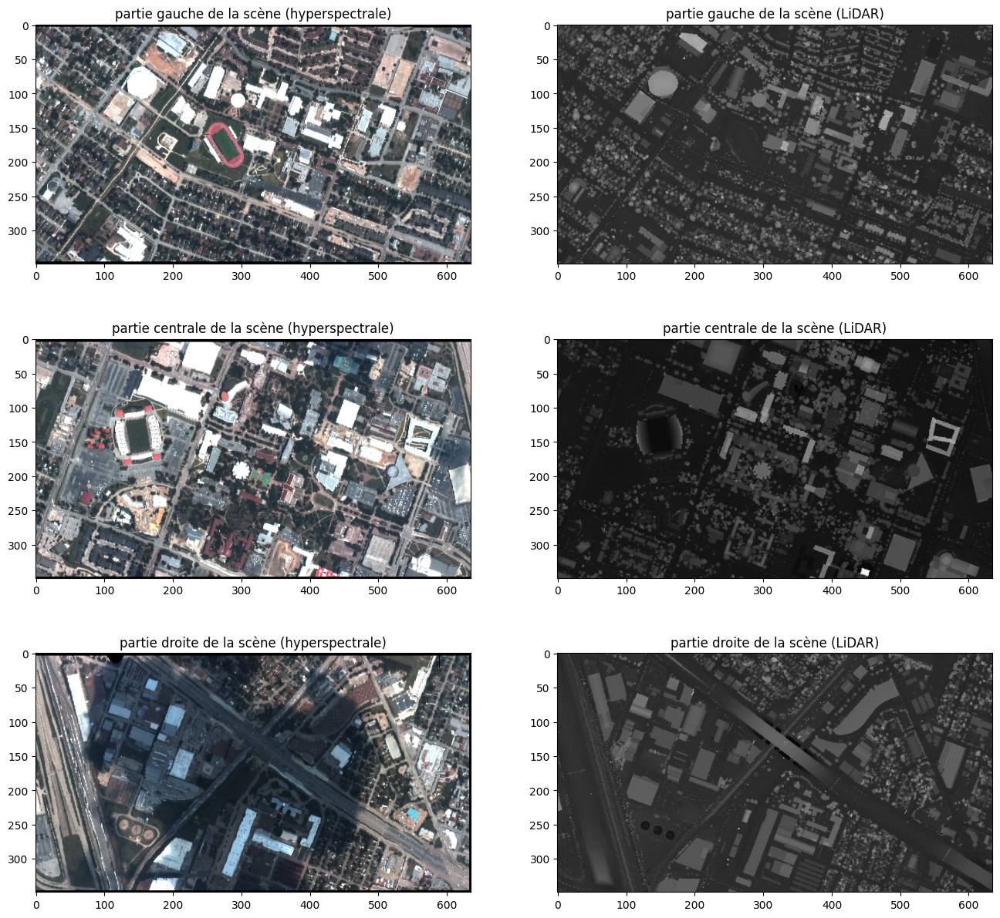

In [11]:
plt.figure(figsize=(16, 15))
plt.subplot(321)
plt.title("partie gauche de la scène (hyperspectrale)")
plt.imshow(hsi_rgb_pimped[:, :635, :])
plt.subplot(322)
plt.title("partie gauche de la scène (LiDAR)")
plt.imshow(lidar[:, :635], cmap="gray")
plt.subplot(323)
plt.title("partie centrale de la scène (hyperspectrale)")
plt.imshow(hsi_rgb_pimped[:, 635:1270, :])
plt.subplot(324)
plt.title("partie centrale de la scène (LiDAR)")
plt.imshow(lidar[:, 635:1270], cmap="gray")
plt.subplot(325)
plt.title("partie droite de la scène (hyperspectrale)")
plt.imshow(hsi_rgb_pimped[:, 1270:, :])
plt.subplot(326)
plt.title("partie droite de la scène (LiDAR)")
plt.imshow(lidar[:, 1270:], cmap="gray")
plt.show()

## Chargement de la vérité terrain

Dans la scène présentée ci-dessus, 15 classes sémantiques ont été définies par les organisateurs du _Data Fusion Contest 2013_, et des zones au sol correspondant à ces différentes classes ont été identifées. Ces différentes zones de références constituent la vérité terrain, dont une partie vous est fournie dans le cadre du projet (la partie manquante, qui vous est cachée, servira de base de test pour la validation de votre solution).

In [12]:
%%bash
if [ -d "groundtruth" ]; then
    echo "Le dossier groundtruth existe déjà"
else
    mkdir -p "groundtruth"
    wget -q "https://www.lrde.epita.fr/~gtochon/IML/groundtruth.zip" -P "groundtruth"
    unzip -q "groundtruth/*.zip" -d "groundtruth"
    rm "groundtruth/"*.zip*
fi

Le dossier groundtruth existe déjà


In [13]:
groundtruth = np.load("groundtruth/groundtruth.npy")
groundtruth_info = np.load("groundtruth/groundtruth_info.npy", allow_pickle=True)
groundtruth_rgb = plt.imread("groundtruth/groundtruth.png")

La vérité terrain qui vous est fournie dans le cadre du projet est composée de trois fichiers : 
* `groundtruth_info` : un récapitulatif des différentes classes sémantiques (numérotées de 1 à 15) 

In [14]:
groundtruth_info

array([{'class_name': 'grass_healthy', 'class_label': 1, 'class_color': array([  0, 205,   0])},
       {'class_name': 'grass_stressed', 'class_label': 2, 'class_color': array([127, 255,   0])},
       {'class_name': 'grass_synthetic', 'class_label': 3, 'class_color': array([ 46, 205,  87])},
       {'class_name': 'tree', 'class_label': 4, 'class_color': array([  0, 139,   0])},
       {'class_name': 'soil', 'class_label': 5, 'class_color': array([160,  82,  45])},
       {'class_name': 'water', 'class_label': 6, 'class_color': array([  0, 255, 255])},
       {'class_name': 'residential', 'class_label': 7, 'class_color': array([255, 255, 255])},
       {'class_name': 'commercial', 'class_label': 8, 'class_color': array([216, 191, 216])},
       {'class_name': 'road', 'class_label': 9, 'class_color': array([255,   0,   0])},
       {'class_name': 'highway', 'class_label': 10, 'class_color': array([139,   0,   0])},
       {'class_name': 'railway', 'class_label': 11, 'class_color': array

Chaque classe est composée d'environ $190$ pixels (ce qui est peu...)

In [15]:
for ii in range(15):
    print(
        "Classe %d : %s (%d pixels au total)"
        % (ii + 1, groundtruth_info[ii]["class_name"], (groundtruth == ii + 1).sum())
    )

Classe 1 : grass_healthy (198 pixels au total)
Classe 2 : grass_stressed (190 pixels au total)
Classe 3 : grass_synthetic (192 pixels au total)
Classe 4 : tree (188 pixels au total)
Classe 5 : soil (186 pixels au total)
Classe 6 : water (182 pixels au total)
Classe 7 : residential (196 pixels au total)
Classe 8 : commercial (191 pixels au total)
Classe 9 : road (193 pixels au total)
Classe 10 : highway (191 pixels au total)
Classe 11 : railway (181 pixels au total)
Classe 12 : parking_lot1 (192 pixels au total)
Classe 13 : parking_lot2 (184 pixels au total)
Classe 14 : tennis_court (181 pixels au total)
Classe 15 : running_track (187 pixels au total)


* `groundtruth` : la position spatiale dans la scène des différents pixels appartenant à ces 15 classes thématiques. Chaque pixel appartenant à la i$^e$ classe est donc de valeur $i$ dans cette carte de vérité terrain (par convention, tous les pixels dont la classe est inconnue sont de valeur $0$).

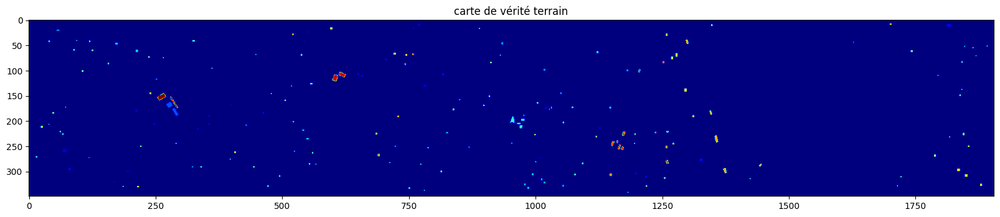

In [16]:
plt.figure(figsize=(20, 5))
plt.title("carte de vérité terrain")
plt.imshow(groundtruth, cmap="jet")
plt.show()

* `groundtruth.png` : pour faciliter la visualisation des différentes classes composant la vérité terrain, on peut également attribuer à chaque classe une couleur (arbitraire), et représenter la vérité terrain comme une image RGB.

In [17]:
cls_rgb = []
for ii in groundtruth_info:
    cls_rgb.append(ii["class_color"])
cls_rgb = np.array(cls_rgb).reshape(15, -1, 3)
cls_rgb

array([[[  0, 205,   0]],

       [[127, 255,   0]],

       [[ 46, 205,  87]],

       [[  0, 139,   0]],

       [[160,  82,  45]],

       [[  0, 255, 255]],

       [[255, 255, 255]],

       [[216, 191, 216]],

       [[255,   0,   0]],

       [[139,   0,   0]],

       [[100, 100, 100]],

       [[255, 255,   0]],

       [[238, 154,   0]],

       [[ 85,  26, 139]],

       [[255, 127,  80]]])

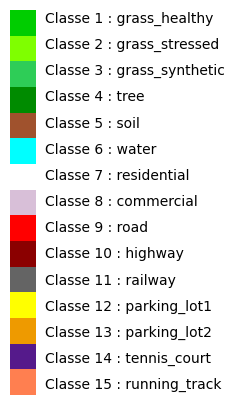

In [18]:
plt.figure(figsize=(5, 5))
plt.imshow(cls_rgb)
plt.axis("off")
for cls in range(15):
    plt.text(
        0.85,
        1.02 * cls,
        "Classe %d : %s" % (cls + 1, groundtruth_info[cls]["class_name"]),
    )
plt.show()

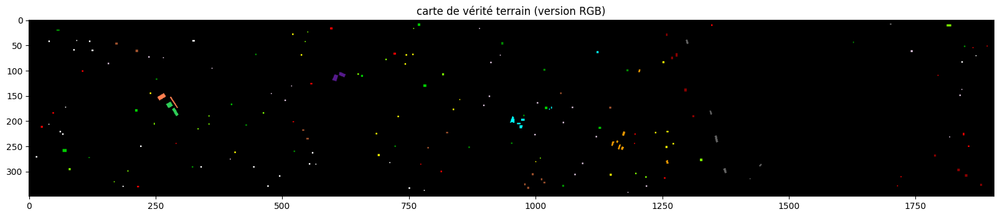

In [19]:
plt.figure(figsize=(20, 5))
plt.title("carte de vérité terrain (version RGB)")
plt.imshow(groundtruth_rgb)
plt.show()

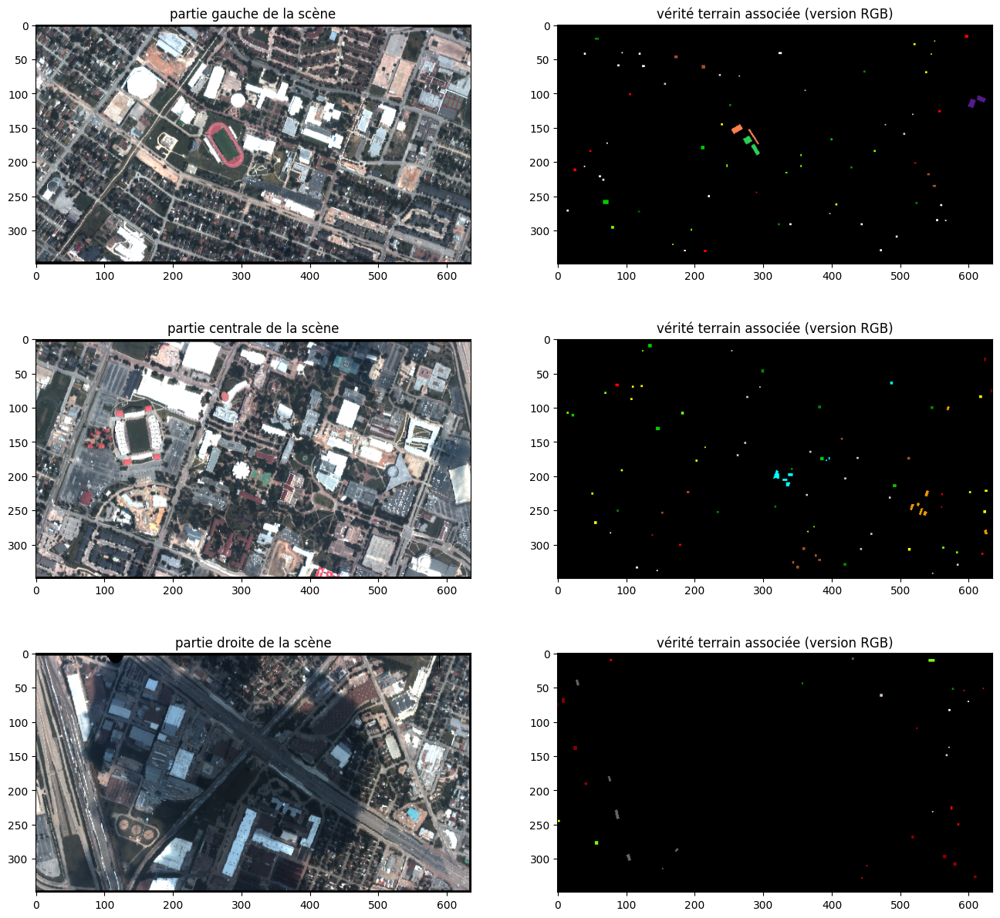

In [20]:
plt.figure(figsize=(16, 15))
plt.subplot(321)
plt.title("partie gauche de la scène")
plt.imshow(hsi_rgb_pimped[:, :635, :])
plt.subplot(322)
plt.title("vérité terrain associée (version RGB)")
plt.imshow(groundtruth_rgb[:, :635, :], cmap="gray")
plt.subplot(323)
plt.title("partie centrale de la scène")
plt.imshow(hsi_rgb_pimped[:, 635:1270, :])
plt.subplot(324)
plt.title("vérité terrain associée (version RGB)")
plt.imshow(groundtruth_rgb[:, 635:1270, :], cmap="gray")
plt.subplot(325)
plt.title("partie droite de la scène")
plt.imshow(hsi_rgb_pimped[:, 1270:, :])
plt.subplot(326)
plt.title("vérité terrain associée (version RGB)")
plt.imshow(groundtruth_rgb[:, 1270:, :], cmap="gray")
plt.show()

## Objectif du projet

L'objectif du projet est d'effectuer **la classification sémantique des pixels de la scène**, c'est-à-dire assigner à chaque pixel l'identifiant (entre 1 et 15) de la classe à laquelle il appartient. Par exemple, tous les pixels de maison doivent être assignés à la classe $7$ (`residential`), tous les pixels de route doivent être assignés à la classe $9$ (`road`), etc.

Les images hyperspectrales (réflectance) et LiDAR (hauteur) portent une information complémentaire car de nature physique différente. Deux zones adjacentes dans la scène peuvent avoir des réponses spectrales très proches (par exemple, de la végétation et de l'herbe), mais des hauteurs différentes dans le LiDAR. À l'inverse, deux zones adjacentes peuvent avoir des hauteurs identiques dans l'image LiDAR (par exemple, de l'herbe et de la route) mais des réponses spectrales très différentes. Ainsi, votre solution devra, d'une manière ou d'une autre, fusionner l'information issue de l'image LiDAR avec celle de l'image hyperspectrale.

Votre solution devra prendre en entrée les deux images (hyperspectrale et LiDAR) et produire en sortie une carte de classification thématique, où chaque pixel a pour valeur le numéro de la classe à laquelle il appartient. Vous pouvez vous servir de toutes les ressources disponibles dans les bibliothèques `scikit-learn`, `scikit-image`, `numpy` et `scipy`, ainsi que de vos connaissances en traitement d'image (pour par exemple pré-traiter les données d'une manière ou d'une autre, ou post-traiter le résultat de classification).

Votre notebook devra :

- contenir votre code et toutes les explications qui nous permettront de comprendre et valider votre démarche
- exporter votre prédiction finale sur toute l'image au format `.npy` (voir ci-après) dans le même format que la vérité terrain
- préciser la contribution de chaque membre du groupe.

<u> pro tip </u> : une image hyperspectrale est nativement représentée comme un cube de données de dimensions $r \times c \times N$ où $r$ et $c$ correspondent au nombre de lignes et de colonnes dans l'image, et $N$ est le nombre de canaux, ce qui ne correspond pas au format attendu par la plupart des algorithmes de `scikit-image` ($N_{samples} \times N_{features}$, où $N_{samples}$ est le nombre d'échantillons et $N_{features}$ est le nombre de caractéristiques (la dimensionalité) de chaque échantillon). 
<br> Pour transformer une image hyperspectrale au format standard de `scikit-image`, on pourra simplement utiliser `hsi.reshape(rc,N)`

## Export des résultats

Nous vous fournissons ici le code pour exporter vos résultats au bon format.

Il vous suffit d'utiliser la fonction `export_predictions()` ci-dessous, en vous assurant qu'elle ne renvoie pas d'erreurs.

In [21]:
def export_predictions(predictions: np.array, filename: str):
    """
    Exporte les prédictions dans un fichier NPZ.
    :param predictions: np.array de shape (349, 1905) et de dtype uint8 contenant les prédictions
    :param filename: nom du fichier de sortie
    """
    # Check we have the right shape and dtype
    if predictions.shape != (349, 1905):
        raise ValueError("Les prédictions doivent être de shape (349, 1905)")
    if predictions.dtype != np.uint8:
        raise ValueError("Les prédictions doivent être de dtype uint8")
    # Check predictions are in the correct domain
    if np.any(predictions > 15):
        raise ValueError("Les prédictions doivent être dans l'intervalle [0, 15]")
    # Ensure the output file has the right extension
    if not filename.endswith(".npz"):
        filename += ".npz"
    # Save the predictions
    np.savez_compressed(filename, predictions=predictions)
    # Remind students to submit the file
    print(
        f"Prédictions exportées dans {filename}, n'oubliez pas d'envoyer votre fichier !"
    )

In [22]:
# Exemples d'exports
predictions_random = np.random.randint(0, 16, size=(349, 1905), dtype=np.uint8)
export_predictions(predictions_random, "predictions_random.npz")

predictions_ones = np.ones((349, 1905), dtype=np.uint8)
export_predictions(predictions_ones, "predictions_ones.npz")

predictions_gt = groundtruth
export_predictions(predictions_gt, "predictions_groundtruth.npz")

Prédictions exportées dans predictions_random.npz, n'oubliez pas d'envoyer votre fichier !
Prédictions exportées dans predictions_ones.npz, n'oubliez pas d'envoyer votre fichier !
Prédictions exportées dans predictions_groundtruth.npz, n'oubliez pas d'envoyer votre fichier !


Voici également une fonction qui vous permet d'évaluer la performance de votre approche par rapport à une cible attendue.
Dans votre cas, vous n'aurez pas accès à la vérité terrain sur le jeu de test mais :
- vous pouvez (devez ?) tester la performance de votre approche sur le jeu d'entraînement (et sur d'éventuels jeux de validation que vous pourriez définir)
- vous avez accès au code d'évaluation que nous utiliserons pour évaluer la performance de votre approche

In [23]:
def eval_performance_raw(predictions: np.array, targets: np.array):
    """Evalue la performance de l'algorithme de classification.

    Args:
        predictions (np.array): prédictions
        targets (np.array): valeurs attendues (vérité terrain)
    """
    # Check we have the right shape and dtype
    if predictions.shape != (349, 1905):
        raise ValueError("Les prédictions doivent être de shape (349, 1905)")
    if predictions.dtype != np.uint8:
        raise ValueError("Les prédictions doivent être de dtype uint8")
    if targets.shape != (349, 1905):
        raise ValueError("Les cibles doivent être de shape (349, 1905)")
    if targets.dtype != np.uint8:
        raise ValueError("Les cibles doivent être de dtype uint8")
    # Check predictions are in the correct domain
    if np.any(predictions > 15):
        raise ValueError("Les prédictions doivent être dans l'intervalle [0, 15]")
    if np.any(targets > 15):
        raise ValueError("Les cibles doivent être dans l'intervalle [0, 15]")
    # Compute the confusion matrix
    confusion_matrix = np.zeros((16, 16), dtype=np.int32)
    for i in range(16):
        for j in range(16):
            confusion_matrix[i, j] = np.sum((predictions == i) & (targets == j))
    # Compute the overall accuracy
    accuracy = np.sum(np.diag(confusion_matrix)) / np.sum(confusion_matrix)
    # Compute the class-wise accuracy
    class_accuracy = np.diag(confusion_matrix) / np.sum(confusion_matrix, axis=1)
    # Accuracy ignoring the unclassified pixels in the ground truth
    mask = targets != 0
    accuracy_no_unclassified = np.sum(predictions[mask] == targets[mask]) / np.sum(mask)
    # Return the results
    return accuracy, class_accuracy, accuracy_no_unclassified, confusion_matrix

In [24]:
def load_eval_perf(filename: str, targets: np.array):
    """
    Charge les prédictions depuis un fichier NPZ et évalue la performance de l'algorithme de classification.

    Args:
        filename (str): nom du fichier NPZ contenant les prédictions
        targets (np.array): valeurs attendues (vérité terrain)
    """
    # Load the predictions
    predictions = np.load(filename)["predictions"]
    # Evaluate the performance
    return eval_performance_raw(predictions, targets)

Évaluation de predictions_ones.npz:
Mean accuracy (micro, no background): 0.07
Mean accuracy (macro, no background): nan


/tmp/ipykernel_94647/3770553655.py:30: RuntimeWarning: invalid value encountered in divide
  class_accuracy = np.diag(confusion_matrix) / np.sum(confusion_matrix, axis=1)


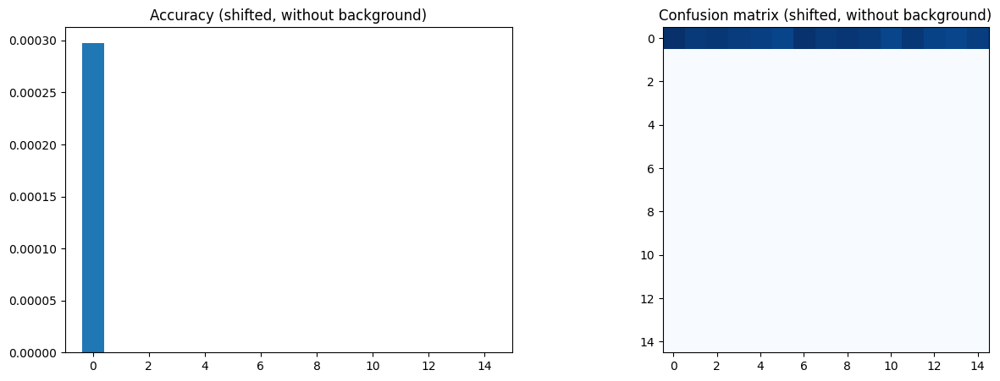

Évaluation de predictions_groundtruth.npz:
Mean accuracy (micro, no background): 1.00
Mean accuracy (macro, no background): 1.00


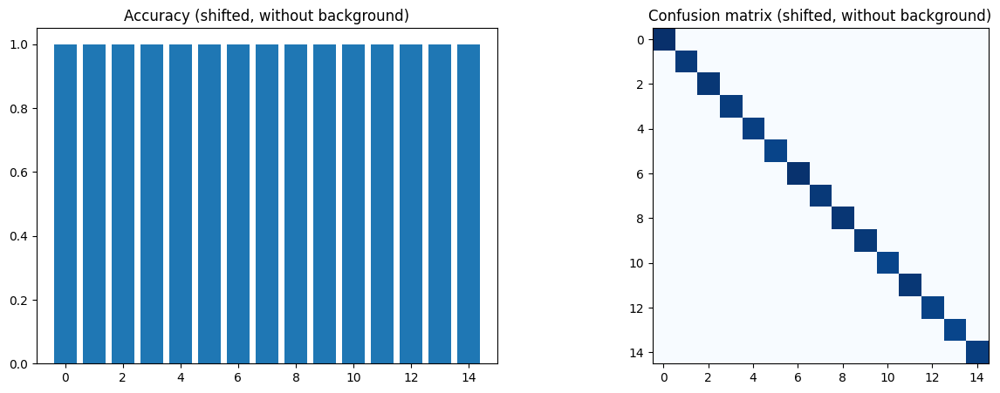

Évaluation de predictions_random.npz:
Mean accuracy (micro, no background): 0.06
Mean accuracy (macro, no background): 0.00


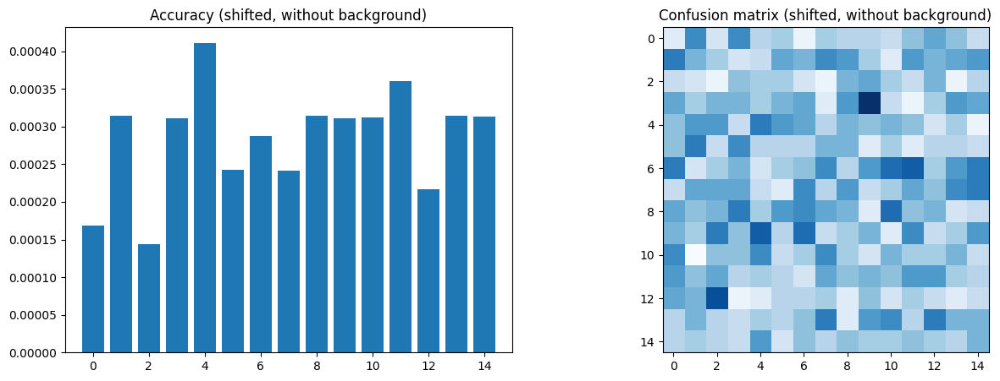

In [25]:
# Exemples d'évaluation
import glob

prediction_files = glob.glob("predictions_*.npz")
groundtruth = np.load("groundtruth/groundtruth.npy")
for file in prediction_files:
    print(f"Évaluation de {file}:")
    accuracy, class_accuracy, accuracy_no_unclassified_micro, confusion_matrix = (
        load_eval_perf(file, groundtruth)
    )
    print(f"Mean accuracy (micro, no background): {accuracy_no_unclassified_micro:.2f}")
    accuracy_no_unclassified_macro = np.mean(class_accuracy[1:])
    print(f"Mean accuracy (macro, no background): {accuracy_no_unclassified_macro:.2f}")
    # Display results
    plt.figure(figsize=(15, 5))
    plt.subplot(121)
    plt.title("Accuracy (shifted, without background)")
    plt.bar(range(15), class_accuracy[1:])
    plt.xlim(-1, 15)
    plt.subplot(122)
    plt.title("Confusion matrix (shifted, without background)")
    plt.imshow(confusion_matrix[1:, 1:], cmap="Blues")
    plt.show()

# À vous de jouer !

In [26]:
import gzip
import os
import pickle
from dataclasses import dataclass
from enum import Enum
from math import ceil, floor

import numpy as np
import seaborn as sns
import skimage.morphology as sm
from matplotlib import pyplot as plt
from scipy.ndimage import median_filter, minimum_filter
from skimage.feature import local_binary_pattern, multiscale_basic_features
from skimage.measure import label, regionprops
from skimage.morphology import binary_dilation, closing, opening, square
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import LinearSVC

### Some utils

In [27]:
class Classes(int, Enum):
    UNKNOWN = 0
    GRASS_HEALTHY = 1
    GRASS_STRESSED = 2
    GRASS_SYNTHETIC = 3
    TREE = 4
    SOIL = 5
    WATER = 6
    RESIDENTIAL = 7
    COMMERCIAL = 8
    ROAD = 9
    HIGHWAY = 10
    RAILWAY = 11
    PARKING_LOT1 = 12
    PARKING_LOT2 = 13
    TENNIS_COURT = 14
    RUNNING_TRACK = 15

In [28]:
_COLORS = np.array(
    [
        [0.0, 0.0, 0.0],
        [0.0, 0.80392157, 0.0],
        [0.49803922, 1.0, 0.0],
        [0.18039216, 0.80392157, 0.34117647],
        [0.0, 0.54509804, 0.0],
        [0.62745098, 0.32156863, 0.17647059],
        [0.0, 1.0, 1.0],
        [1.0, 1.0, 1.0],
        [0.84705882, 0.74901961, 0.84705882],
        [1.0, 0.0, 0.0],
        [0.54509804, 0.0, 0.0],
        [0.39215686, 0.39215686, 0.39215686],
        [1.0, 1.0, 0.0],
        [0.93333333, 0.60392157, 0.0],
        [0.33333333, 0.10196078, 0.54509804],
        [1.0, 0.49803922, 0.31372549],
    ]
)


def display_mask(img, cmap="gray"):
    plt.figure(figsize=(15, 15))
    plt.imshow(img, cmap=cmap)


def display_prediction(img_pred):
    plt.figure(figsize=(15, 15))
    h, w = img_pred.shape[:2]
    plt.imshow(_COLORS[img_pred.reshape(-1).astype(np.int8)].reshape((h, w, 3)))


def display_confusion_matrix(y_true, y_pred):
    cmat = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    class_names = [_class.name for _class in Classes][1:]
    sns.heatmap(
        cmat,
        xticklabels=class_names,
        yticklabels=class_names,
        annot=True,
        cmap="Blues",
        fmt="d",
    )
    plt.xlabel("Predicted labels")
    plt.ylabel("True labels")
    plt.title("Confusion Matrix")
    plt.show()

In [29]:
class Classifier:
    def __init__(self, classes, model, random_state=42):
        self._random_state = random_state
        self._classes = classes
        self._model = model
        self._estimator = make_pipeline(StandardScaler(), self._model)

    def fit(self, X, y):
        mask = np.isin(y, self._classes)
        y[~mask] = Classes.UNKNOWN
        return self._estimator.fit(X, y)

    def score(self, X, y):
        y_pred = self.predict(X)
        mask = np.isin(y, self._classes)
        y[~mask] = Classes.UNKNOWN
        return accuracy_score(y, y_pred)

    def predict(self, X):
        return self._estimator.predict(X)

    def _dataset_get(self, X, y, include_unknown=False, n_splits=1, test_size=0.2):
        splitter = StratifiedShuffleSplit(
            n_splits=n_splits, random_state=self._random_state, test_size=test_size
        )
        mask = np.isin(y, self._classes)
        X_bis, y_bis = X.copy(), y.copy()
        if include_unknown:
            y_bis[~mask] = Classes.UNKNOWN
        else:
            X_bis, y_bis = X_bis[mask], y_bis[mask]
        train_idx, test_idx = next(splitter.split(X_bis, y_bis))
        return X_bis[train_idx], y_bis[train_idx], X_bis[test_idx], y_bis[test_idx]

    def optimize(
        self,
        X,
        y,
        include_unknown=False,
        scaler_params=dict(),
        model_params=dict(),
        **grid_kwargs,
    ):
        estimator_steps_names = list(self._estimator.named_steps)
        assert len(estimator_steps_names) > 1
        params = dict()
        for name, values in scaler_params.items():
            params[f"{estimator_steps_names[0]}__{name}"] = values
        for name, values in model_params.items():
            params[f"{estimator_steps_names[1]}__{name}"] = values
        X_train, y_train, X_test, y_test = self._dataset_get(
            X, y, include_unknown=include_unknown
        )
        cv = GridSearchCV(self._estimator, params, **grid_kwargs)
        cv.fit(X_train, y_train)
        best_score = cv.score(X_test, y_test)
        if best_score > self._estimator.score(X_test, y_test):
            self._estimator = cv.best_estimator_
        return best_score

### Data

In [30]:
mask_known = groundtruth != Classes.UNKNOWN
mask_unknown = ~mask_known
y = groundtruth[mask_known]

# Naive Approach

The naive approach consists in simply feeding a fusion of given features to different models and hope for a miracle.

In [31]:
features = np.dstack((hsi_raw, lidar))

In [32]:
X = np.hstack((hsi_raw[mask_known], lidar[mask_known].reshape(-1, 1)))
# y was already defined above

X.shape, y.shape

((2832, 145), (2832,))

### LinearSVC

In [33]:
svc = LinearSVC(random_state=42, dual="auto", max_iter=2000)
clf_svc = Classifier(list(Classes), svc)

In [34]:
X_train, y_train, X_test, y_test = clf_svc._dataset_get(X, y)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2265, 145), (2265,), (567, 145), (567,))

In [35]:
clf_svc.fit(X_train, y_train)
clf_svc.score(X_test, y_test)

0.8888888888888888

Seems decent for a first try. Let's try to optimize it a bit.

In [36]:
# Uncomment this block of code to reproduce

# clf_svc.optimize(
#     X,
#     y,
#     model_params=dict(
#         C=(1, 10, 50),
#         max_iter=(1000, 2000, 3000),
#         penalty=("l1", "l2"),
#     ),
#     n_jobs=16,
#     verbose=1,
# )

Fitting 5 folds for each of 18 candidates, totalling 90 fits


/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/ucin/.local/lib/python3.11/site-packages/sklearn/svm/_base.py:1237: ConvergenceWarning: Liblinear failed to conver

0.9065255731922398

Slightly better.

In [37]:
y_pred_svc = clf_svc.predict(features.reshape(-1, features.shape[-1]))
img_pred_svc = y_pred_svc.reshape(lidar.shape)

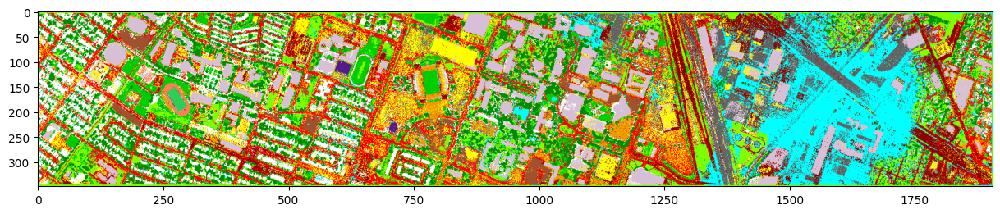

In [38]:
display_prediction(img_pred_svc)

### SGDClassifier

In [39]:
sgdc = SGDClassifier(
    random_state=42,
    shuffle=False,
    early_stopping=True,
    n_jobs=4,
)
clf_sgdc = Classifier(list(Classes), sgdc)

In [40]:
X_train, y_train, X_test, y_test = clf_sgdc._dataset_get(X, y)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2265, 145), (2265,), (567, 145), (567,))

In [41]:
clf_sgdc.fit(X_train, y_train)
clf_sgdc.score(X_test, y_test)

0.7195767195767195

The score is way worse than the first score of the LinearSVC Classifier. Let's try to optimize it.

In [42]:
# Uncomment this block of code to reproduce

# clf_sgdc.optimize(
#     X,
#     y,
#     model_params=dict(
#         loss=("log_loss", "squared_error", "hinge"),
#         alpha=(0.0001, 0.001, 0.01),
#         max_iter=(1000, 2000, 3000),
#     ),
#     n_jobs=16,
#     verbose=1,
# )

Fitting 5 folds for each of 27 candidates, totalling 135 fits


0.7195767195767195

No real change for the chosen parameters.

In [43]:
y_pred_sgdc = clf_svc.predict(features.reshape(-1, features.shape[-1]))
img_pred_sgdc = y_pred_sgdc.reshape(lidar.shape)

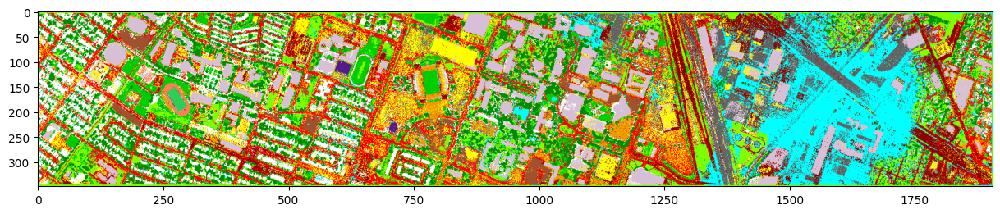

In [44]:
display_prediction(img_pred_sgdc)

Even though the score is better for the LinearSVC classifier, the result image seems pretty similar.

### RandomForestClassifier

In [45]:
rfc = RandomForestClassifier(n_estimators=128, random_state=42)
clf_rfc = Classifier(list(Classes), rfc)

In [46]:
X_train, y_train, X_test, y_test = clf_rfc._dataset_get(X, y)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2265, 145), (2265,), (567, 145), (567,))

In [47]:
clf_rfc.fit(X_train, y_train)
clf_rfc.score(X_test, y_test)

0.9012345679012346

Wow, not bad from the first try. Hopelly it does not overfit the data.

In [48]:
# Uncomment this block of code to reproduce

# clf_rfc.optimize(
#     X,
#     y,
#     model_params=dict(
#         n_estimators=(32, 64, 128, 256),
#         criterion=("entropy", "gini"),
#         max_features=("sqrt", None),
#     ),
#     n_jobs=16,
#     verbose=1,
# )

Fitting 5 folds for each of 16 candidates, totalling 80 fits


0.9312169312169312

Slightly better. Surely more can be done.

In [49]:
y_pred_rfc = clf_rfc.predict(features.reshape(-1, features.shape[-1]))
img_pred_rfc = y_pred_rfc.reshape(lidar.shape)

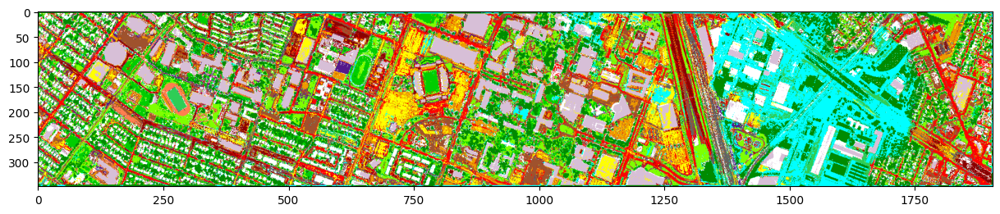

In [50]:
display_prediction(img_pred_rfc)

### HistGradientBoostingClassifier

In [51]:
hgbc = HistGradientBoostingClassifier(max_iter=150, random_state=42)
clf_hgbc = Classifier(list(Classes), hgbc)

In [52]:
X_train, y_train, X_test, y_test = clf_hgbc._dataset_get(X, y)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2265, 145), (2265,), (567, 145), (567,))

In [53]:
clf_hgbc.fit(X_train, y_train)
clf_hgbc.score(X_test, y_test)

0.9506172839506173

Wow, very promissing, at least, from a score perspective.

In [54]:
y_pred_hgbc = clf_hgbc.predict(features.reshape(-1, features.shape[-1]))
img_pred_hgbc = y_pred_hgbc.reshape(lidar.shape)

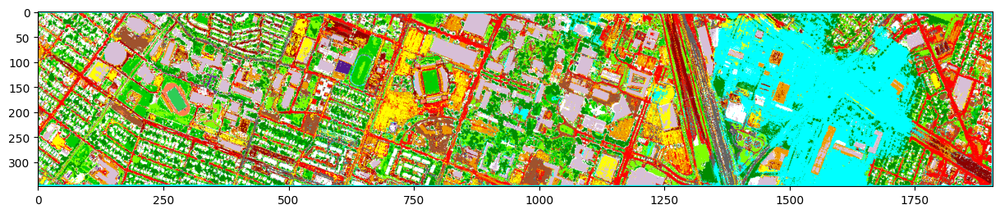

In [55]:
display_prediction(img_pred_hgbc)

Even though the score is much better, the shadow part is still incorrect.

# Shadow Mask

In [56]:
def display_shadow(mask):
    plt.figure(figsize=(20, 8))
    plt.subplot(211)
    plt.title("Version RGB de l'image hyperspectrale")
    plt.imshow(hsi_rgb_pimped)
    plt.subplot(212)
    plt.title("Shadow mask")
    plt.imshow(mask, cmap="gray")
    plt.show()

### Shadow mask detection

In an HSI space for RGB image, the intensity component is calculated as follows: 
$$I = avg(R, G,B) = \frac{R + G + B}{3}$$

So we calculated only the intensity component, and found a threshold for which the shadow was detected.

In [57]:
def detect_shadows_mask(image, threshold):
    m_intensity = np.mean(image, axis=2)
    threshold = np.percentile(m_intensity, threshold)
    mask = m_intensity < threshold
    return mask

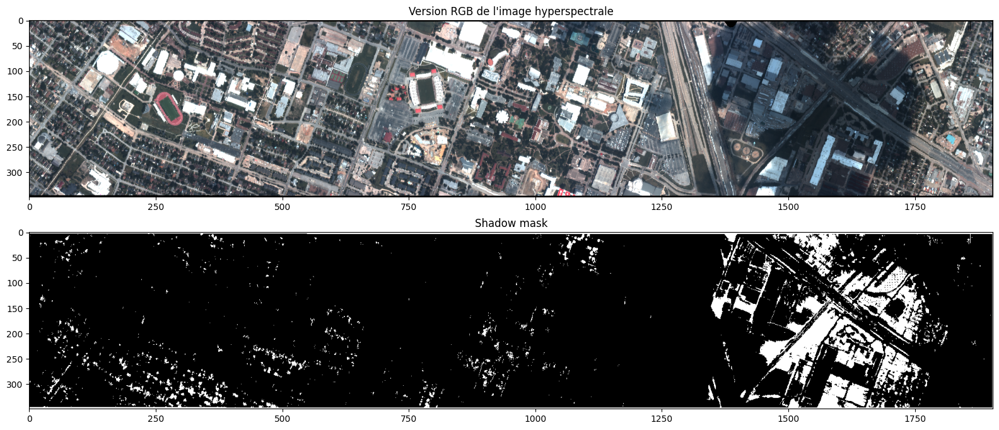

In [58]:
shadow_mask_from_rgb = detect_shadows_mask(hsi_rgb_pimped, 10)
display_shadow(shadow_mask_from_rgb)

The slightly darker areas were detected as shadows, but by lowering the shadow detection threshold, it's quite difficult to post-process them to get a consistent result. We noticed that by averaging all the features and applying a threshold the shadow was better detected.

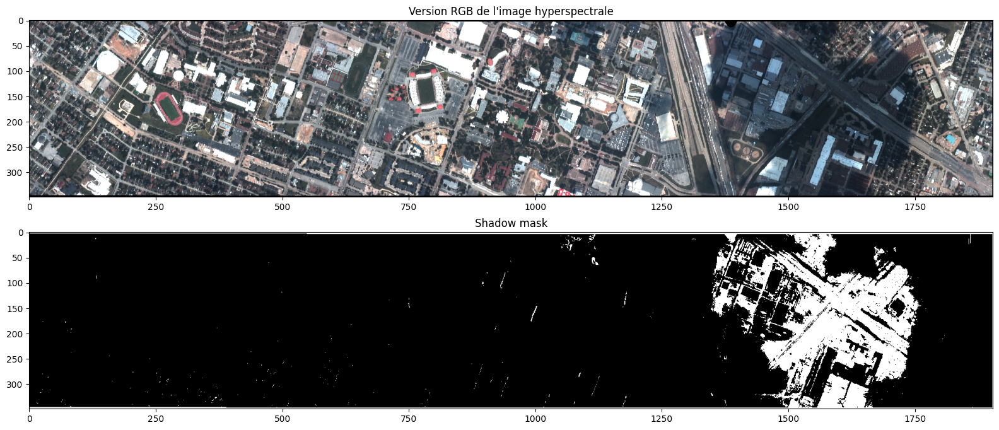

In [59]:
shadow_mask = detect_shadows_mask(hsi_raw, 11)
display_shadow(shadow_mask)

### Shadow Mask Post-Processing

In [60]:
def detect_shadow_and_post_process(image):
    mask = detect_shadows_mask(image, 11)
    shadow_pp = sm.opening(mask, sm.square(3))
    shadow_pp = sm.closing(shadow_pp, sm.disk(25))
    return shadow_pp

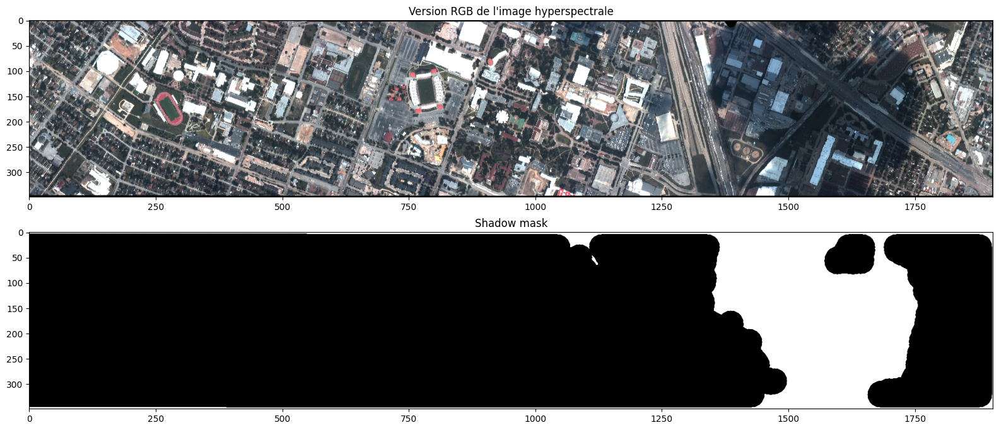

In [61]:
shadow_mask = detect_shadow_and_post_process(hsi_raw)
display_shadow(shadow_mask)

### Train a classifier which takes into account the shadow mask

In [62]:
features = np.dstack((hsi_raw, lidar, shadow_mask))

In [63]:
X = np.hstack(
    (
        hsi_raw[mask_known],
        shadow_mask[mask_known].reshape(-1, 1),
        lidar[mask_known].reshape(-1, 1),
    )
)
# y was already defined above

X.shape

(2832, 146)

In [64]:
hgbc = HistGradientBoostingClassifier(max_iter=150, random_state=42)
clf_hgbc = Classifier(list(Classes), hgbc)

In [65]:
X_train, y_train, X_test, y_test = clf_hgbc._dataset_get(X, y)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2265, 146), (2265,), (567, 146), (567,))

In [66]:
clf_hgbc.fit(X_train, y_train)
clf_hgbc.score(X_test, y_test)

0.9506172839506173

In [67]:
y_pred_hgbc = clf_hgbc.predict(features.reshape(-1, features.shape[-1]))
img_pred_hgbc = y_pred_hgbc.reshape(lidar.shape)

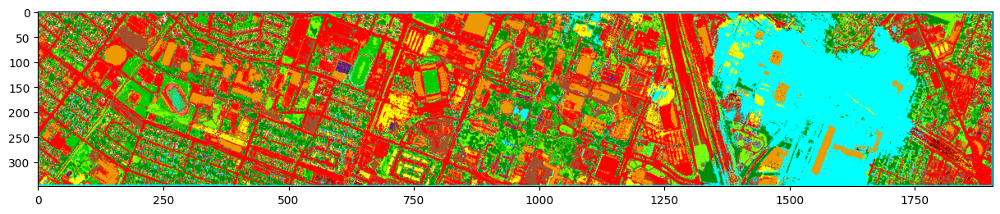

In [68]:
display_prediction(img_pred_hgbc)

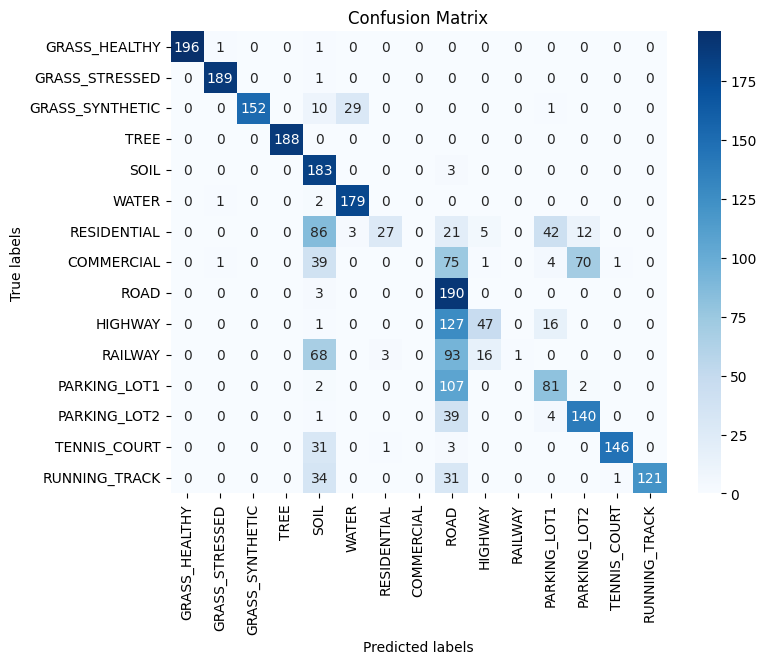

In [69]:
display_confusion_matrix(y, img_pred_hgbc[mask_known])

It is obvious that the shadow mask in this case didn't help. It could be because of the missing groundtruth in the shadow area. In this case, it would be more appropriate to do 2 separate classifiers for the shadow and shadow free zone.

Nevertheless, the results are not that bad for such a naive approach.

# Proposed Solution

In [70]:
_LOWER_BOUND = 380
_UPPER_BOUND = 1050
_BANDS_AMOUNT = 144
_PER_INDEX = (_UPPER_BOUND - _LOWER_BOUND + 1) / _BANDS_AMOUNT

_NIR_WAVELENGTH = 860
_RED_WAVELENGTH = 650
_GREEN_WAVELENGTH = 550
_BLUE_WAVELENGTH = 470


def _wavelength_to_indexes(wl):
    assert wl >= _LOWER_BOUND and wl <= _UPPER_BOUND
    x = (wl - _LOWER_BOUND + 1) / _PER_INDEX
    return floor(x), ceil(x)


class SpectralIndices:
    @staticmethod
    def _get(hsi, wl):
        ii, jj = _wavelength_to_indexes(wl)
        return (hsi[:, :, ii] + hsi[:, :, jj]) / 2

    @staticmethod
    def evi(hsi):
        # enhanced vegetation index
        # evi = (nir - R) / (nir + 6 * R - 7.5 * B + 1)
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        red = SpectralIndices._get(hsi, _RED_WAVELENGTH)
        blue = SpectralIndices._get(hsi, _BLUE_WAVELENGTH)
        return (nir - red) / (nir + 6 * red - 7.5 * blue + 1 + 1e-9)

    @staticmethod
    def mcari(hsi):
        # modified chlorophyll absorption ratio index
        # mcari = (b700 - b670) - (0.2 * (b700 - b550)) * (b700 / b670)
        b550 = SpectralIndices._get(hsi, 550)
        b670 = SpectralIndices._get(hsi, 670)
        b700 = SpectralIndices._get(hsi, 700)
        return (b700 - b670) - (0.2 * (b700 - b550)) * (b700 / (b670 + 1e-9))

    @staticmethod
    def mtvi(hsi):
        # modified triangular vegetation index
        # mtvi = 1.2 * ((1.2 * (b800 - b550)) - (2.5 * (b670 - b550)))
        b550 = SpectralIndices._get(hsi, 550)
        b670 = SpectralIndices._get(hsi, 670)
        b800 = SpectralIndices._get(hsi, 800)
        return 1.2 * ((1.2 * (b800 - b550)) - 2.5 * (b670 - b550))

    @staticmethod
    def ndmi(hsi):
        # normalized difference mud index
        # ndmi = (b795 - b990) / (b795 + b990)
        b795 = SpectralIndices._get(hsi, 795)
        b990 = SpectralIndices._get(hsi, 990)
        return (b795 - b990) / (b795 + b990 + 1e-9)

    @staticmethod
    def ndvi(hsi):
        # normalized difference vegetation index
        # ndvi = (nir - R) / (nir + R)
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        red = SpectralIndices._get(hsi, _RED_WAVELENGTH)
        return (nir - red) / (nir + red + 1e-9)

    @staticmethod
    def ndwi(hsi):
        # normalized difference water index
        # ndwi = (green - nir) / (green + nir)
        green = SpectralIndices._get(hsi, _GREEN_WAVELENGTH)
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        return (green - nir) / (green + nir + 1e-9)

    @staticmethod
    def osavi(hsi):
        # optimized soil adjusted vegetation index
        # osavi = (nir - R) / (nir + R + 0.16)
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        red = SpectralIndices._get(hsi, _RED_WAVELENGTH)
        return (nir - red) / (nir + red + 0.16 + 1e-9)

    @staticmethod
    def pri(hsi):
        # photochemical reflectance index
        # pri = (b531 - b570) / (b531 + b570)
        b531 = SpectralIndices._get(hsi, 531)
        b570 = SpectralIndices._get(hsi, 570)
        return (b531 - b570) / (b531 + b570 + 1e-9)

    @staticmethod
    def sr(hsi):
        # simple ratio
        # sr = nir / R
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        red = SpectralIndices._get(hsi, _RED_WAVELENGTH)
        return nir / (red + 1e-9)

    @staticmethod
    def quot(hsi):
        # quotient of the sum and the difference between 2 bands
        # this allows to decrease the variance in the hyperspectral cube
        red = SpectralIndices._get(hsi, _RED_WAVELENGTH)
        green = SpectralIndices._get(hsi, _GREEN_WAVELENGTH)
        blue = SpectralIndices._get(hsi, _BLUE_WAVELENGTH)
        nir = SpectralIndices._get(hsi, _NIR_WAVELENGTH)
        bands = [red, green, blue, nir]
        bands_amount = len(bands)
        quot = []
        for ii in range(bands_amount):
            for jj in range(bands_amount):
                if ii == jj:
                    continue
                quot.append((bands[ii] - bands[jj]) / (bands[ii] + bands[jj] + 1e-9))
        quot = np.dstack(quot)
        return quot

In [71]:
@dataclass
class BoundaryRect:
    tlx: int
    tly: int
    brx: int
    bry: int


class BoundaryDiscriminator:
    def __init__(
        self,
        rect,
        target_class,
        features_img,
        groundtruth,
        model,
        random_state=42,
    ):
        self._target_class = target_class
        self._rect = rect
        self._estimator = make_pipeline(StandardScaler(), model)
        self._random_state = random_state
        self._init_dataset(features_img, groundtruth)

    def _init_dataset(self, features_img, groundtruth):
        features_known = features_img[groundtruth == self._target_class]
        features_unknown = self._extract_features(features_img)
        features = np.vstack((features_known, features_unknown))
        y = np.zeros(features.shape[:-1])
        y[: features_known.shape[0]] = self._target_class
        y[features_known.shape[0] :] = Classes.UNKNOWN
        self._split_dataset(features, y)

    def _extract_features(self, features_img, step=5):
        rect = self._rect
        features_amount = features_img.shape[-1]
        features_extracted = [
            features_img[: rect.tly : step, ::step],
            features_img[rect.bry :: step, ::step],
            features_img[rect.tly : rect.bry : step, : rect.tlx : step],
            features_img[rect.tly : rect.bry : step, rect.brx :: step],
        ]
        for ii in range(4):
            features_extracted[ii] = features_extracted[ii].reshape(-1, features_amount)
        features = np.vstack(features_extracted)
        return features

    def _split_dataset(self, X, y):
        splitter = StratifiedShuffleSplit(
            n_splits=1, random_state=self._random_state, test_size=0.2
        )
        train_idx, test_idx = next(splitter.split(X, y))
        self._X_train = X[train_idx]
        self._y_train = y[train_idx]
        self._X_test = X[test_idx]
        self._y_test = y[test_idx]

    def fit(self):
        return self._estimator.fit(self._X_train, self._y_train)

    def score(self):
        return self._estimator.score(self._X_test, self._y_test)

    def predict(self, X):
        return self._estimator.predict(X)

    def predict_with_postprocessing(self, features_img, area_threshold=128):
        y_pred = self.predict(features_img.reshape(-1, features_img.shape[-1]))
        img_pred = y_pred.reshape(features_img.shape[:2])
        img_pred = closing(img_pred, square(3))
        img_pred = opening(img_pred)
        img_pred = label(img_pred)
        props = regionprops(img_pred)
        for prop in props:
            if prop.area < area_threshold:
                img_pred[img_pred == prop.label] = Classes.UNKNOWN
        img_pred[img_pred != Classes.UNKNOWN] = self._target_class
        return img_pred

In [72]:
%%bash
mkdir -p models/

In [73]:
_MODELS_DIR = "./models"


def model_save(model, name):
    with gzip.open(os.path.join(_MODELS_DIR, f"{name}.pkl"), "wb") as f:
        pickle.dump(model, f)


def model_load(name):
    with gzip.open(os.path.join(_MODELS_DIR, f"{name}.pkl"), "rb") as f:
        return pickle.load(f)


def model_exists(name):
    return os.path.isfile(os.path.join(_MODELS_DIR, f"{name}.pkl"))

### Pre-processing

In [74]:
# for lidar normalization

def compute_ground_height(lidar, window_size=256):
    padding_size = window_size // 2
    padded = np.pad(lidar, padding_size, mode="constant", constant_values=+np.inf)
    local_mins = minimum_filter(padded, size=window_size)
    ground_height = np.nanmin(local_mins, axis=(0, 1))
    return ground_height

In [75]:
lidar = lidar - compute_ground_height(lidar)

### Features

In [76]:
evi = SpectralIndices.evi(hsi_raw)
mcari = SpectralIndices.mcari(hsi_raw)
mtvi = SpectralIndices.mtvi(hsi_raw)
ndmi = SpectralIndices.ndmi(hsi_raw)
ndvi = SpectralIndices.ndvi(hsi_raw)
ndwi = SpectralIndices.ndwi(hsi_raw)
osavi = SpectralIndices.osavi(hsi_raw)
pri = SpectralIndices.pri(hsi_raw)
sr = SpectralIndices.sr(hsi_raw)
quot = SpectralIndices.quot(hsi_raw)
lbp_lidar = local_binary_pattern(lidar, 24, 3)
mbf_lidar = multiscale_basic_features(lidar).reshape((*lidar.shape, -1))

/home/ucin/.local/lib/python3.11/site-packages/skimage/feature/texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


### 1. Discriminate and classify vegetation

In [77]:
_GRASS_SYNTHETIC_RECT = BoundaryRect(tlx=200, tly=100, brx=350, bry=250)


class VegetationDiscriminator:
    def __init__(self, features_img, groundtruth, random_state=42):
        self._model = BoundaryDiscriminator(
            _GRASS_SYNTHETIC_RECT,
            Classes.GRASS_SYNTHETIC,
            features_img,
            groundtruth,
            model=LinearSVC(C=10, random_state=42, max_iter=2000, dual="auto"),
            random_state=random_state,
        )

    def predict(self, hsi, features_img, threshold=0):
        ndvi = SpectralIndices.ndvi(hsi) > threshold
        mask_synt = self._model.predict_with_postprocessing(features_img)
        mask_synt = mask_synt == Classes.GRASS_SYNTHETIC
        mask_synt = mask_synt.reshape(features_img.shape[:2])
        return ndvi | mask_synt

In [78]:
features_img_vegetation = np.dstack((hsi_raw, lidar, ndvi, osavi, ndwi))
features_img_vegetation.shape

(349, 1905, 148)

In [79]:
discriminator_vegetation = VegetationDiscriminator(features_img_vegetation, groundtruth)
discriminator_vegetation._model.fit()
discriminator_vegetation._model.score()

0.9996148661659927

In [80]:
model_save(discriminator_vegetation, "discriminator_vegetation")

In [81]:
mask_vegetation = discriminator_vegetation.predict(hsi_raw, features_img_vegetation)

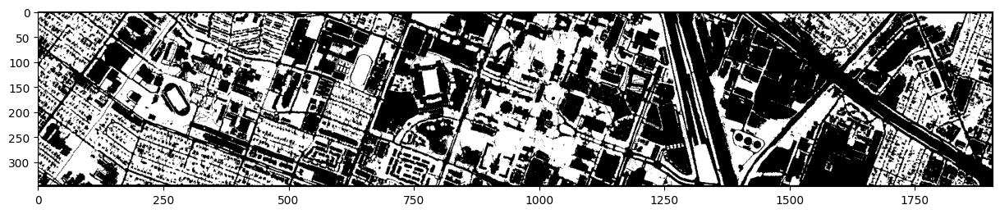

In [82]:
display_mask(mask_vegetation)

It is not ideal but enough to bypass the shadow problem, at least for now.

In [83]:
classes_vegetation = [
    Classes.GRASS_HEALTHY,
    Classes.GRASS_STRESSED,
    Classes.GRASS_SYNTHETIC,
    Classes.TREE,
]
clf_vegetation_model = SGDClassifier(
    random_state=42, shuffle=False, early_stopping=True, n_jobs=4
)
clf_vegetation = Classifier(
    classes_vegetation,
    clf_vegetation_model,
)

In [84]:
X_vegetation = features_img_vegetation[mask_known]
dataset_vegetation = clf_vegetation._dataset_get(X_vegetation, y, include_unknown=False)

In [85]:
clf_vegetation.fit(*dataset_vegetation[:2])
clf_vegetation.score(*dataset_vegetation[2:])

1.0

In [86]:
model_save(clf_vegetation, "classifier_vegetation")

In [87]:
features_vegetation_to_predict = features_img_vegetation[mask_vegetation]
y_pred_vegetation = clf_vegetation.predict(features_vegetation_to_predict)
img_pred_vegetation = np.zeros(features_img_vegetation.shape[:2])
img_pred_vegetation[mask_vegetation] = y_pred_vegetation
np.unique(img_pred_vegetation, return_counts=True)

(array([0., 1., 2., 3., 4.]), array([373759,  56383,  92477,  53433,  88793]))

In [88]:
mask = np.isin(groundtruth, classes_vegetation)
print(classification_report(groundtruth[mask], img_pred_vegetation[mask]))

              precision    recall  f1-score   support

           1       1.00      0.99      1.00       198
           2       0.99      1.00      1.00       190
           3       1.00      1.00      1.00       192
           4       1.00      1.00      1.00       188

    accuracy                           1.00       768
   macro avg       1.00      1.00      1.00       768
weighted avg       1.00      1.00      1.00       768



The classification of the vegetation is pretty straightforward. Good results are obtained without any parametere optimizations.

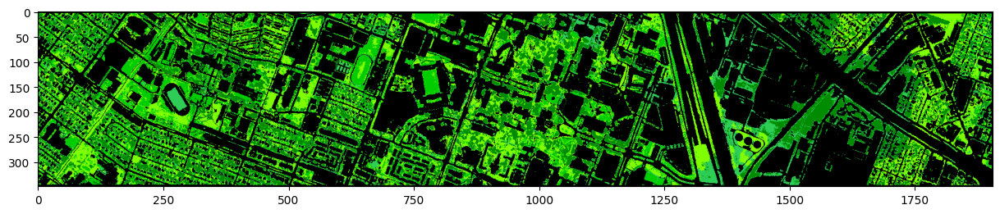

In [89]:
display_prediction(img_pred_vegetation)

### 2. Discriminate running track

In [90]:
features_img_running_track = np.dstack((hsi_raw, lidar))
features_img_running_track.shape

(349, 1905, 145)

In [91]:
_RUNNING_TRACK_RECT = BoundaryRect(tlx=200, tly=100, brx=350, bry=250)

discriminator_running_track = BoundaryDiscriminator(
    _RUNNING_TRACK_RECT,
    Classes.RUNNING_TRACK,
    features_img_running_track,
    groundtruth,
    model=LinearSVC(C=10, random_state=42, max_iter=2000, dual="auto"),
    random_state=42,
)

In [92]:
discriminator_running_track.fit()
discriminator_running_track.score()

1.0

In [93]:
model_save(discriminator_running_track, "discriminator_running_track")

In [94]:
y_pred_running_track = discriminator_running_track.predict_with_postprocessing(
    features_img_running_track
)
mask_running_track = y_pred_running_track.reshape(
    features_img_running_track.shape[:2],
)

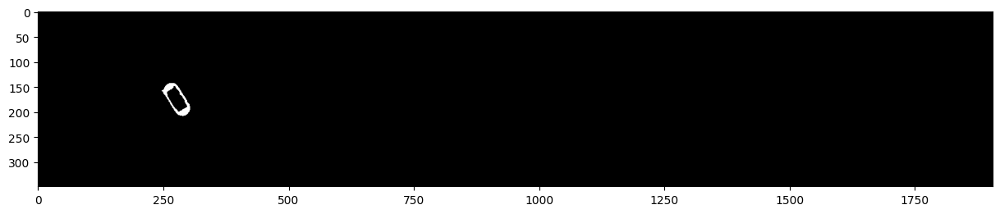

In [95]:
display_mask(mask_running_track)

### 3. Discriminate tennis court

In [96]:
features_img_tennis_court = np.dstack((hsi_raw, lidar))
features_img_tennis_court.shape

(349, 1905, 145)

In [97]:
_TENNIS_COURT_RECT = BoundaryRect(tlx=600, tly=50, brx=700, bry=150)

discriminator_tennis_court = BoundaryDiscriminator(
    _TENNIS_COURT_RECT,
    Classes.TENNIS_COURT,
    features_img_tennis_court,
    groundtruth,
    model=LinearSVC(C=10, random_state=42, max_iter=2000, dual="auto"),
    random_state=42,
)

In [98]:
discriminator_tennis_court.fit()
discriminator_tennis_court.score()

0.9992439992439992

In [99]:
model_save(discriminator_tennis_court, "discriminator_tennis_court")

In [100]:
y_pred_tennis_court = discriminator_tennis_court.predict_with_postprocessing(
    features_img_tennis_court
)
mask_tennis_court = y_pred_tennis_court.reshape(
    features_img_tennis_court.shape[:2],
)

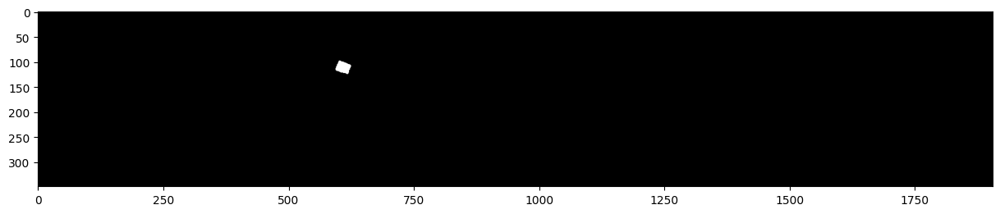

In [101]:
display_mask(mask_tennis_court)

### 4. Discriminate water

In [102]:
_WATER_RECT = BoundaryRect(tlx=700, tly=10, brx=1200, bry=390)


class WaterDiscriminator:
    def __init__(
        self,
        features_img,
        groundtruth,
        random_state=42,
    ):
        self._model = BoundaryDiscriminator(
            _WATER_RECT,
            Classes.WATER,
            features_img,
            groundtruth,
            model=LinearSVC(C=10, random_state=42, max_iter=2000, dual="auto"),
            random_state=random_state,
        )

    def predict(self, hsi, features_img, threshold=0.3):
        mask_ndwi = SpectralIndices.ndwi(hsi) > threshold
        features_amount = features_img.shape[-1]
        y_pred = self._model.predict(features_img.reshape(-1, features_amount))
        img_pred = y_pred.reshape(features_img.shape[:2])
        mask_water = img_pred == Classes.WATER
        mask_water = mask_water.reshape(features_img.shape[:2])
        mask_water = binary_dilation(mask_water, square(7))
        mask_water = mask_water & mask_ndwi
        mask_water = median_filter(mask_water, 3)
        return mask_water

In [103]:
features_img_water = np.dstack((hsi_raw, lidar, ndwi))
features_img_water.shape

(349, 1905, 146)

In [104]:
discriminator_water = WaterDiscriminator(features_img_water, groundtruth)
discriminator_water._model.fit()
discriminator_water._model.score()

0.9992520568436799

Even though the score is pretty good, the classification stage often classifies pixels in the shadow as water ones. Thus there was a post-processing step added which will affect the overall coincidence with groundtruth. 

In [105]:
model_save(discriminator_water, "discriminator_water")

In [106]:
mask_water = discriminator_water.predict(hsi_raw, features_img_water)

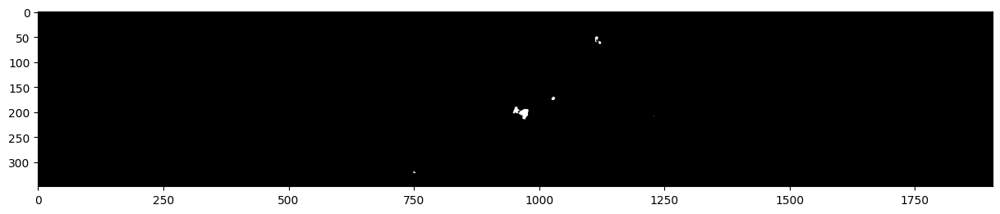

In [107]:
display_mask(mask_water)

### Fusion steps 1-4

In [108]:
img_pred_1_4 = img_pred_vegetation.copy()
img_pred_1_4[mask_running_track != Classes.UNKNOWN] = Classes.RUNNING_TRACK
img_pred_1_4[mask_tennis_court != Classes.UNKNOWN] = Classes.TENNIS_COURT
img_pred_1_4[mask_water != Classes.UNKNOWN] = Classes.WATER

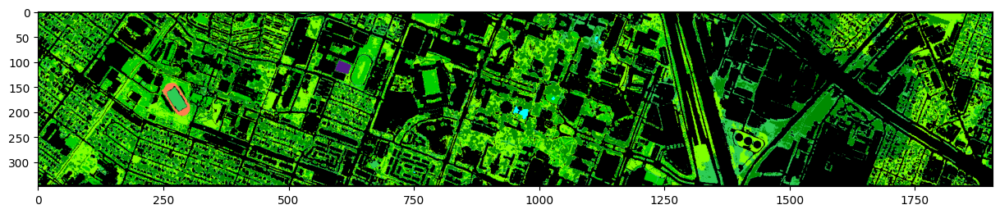

In [109]:
display_prediction(img_pred_1_4)

### 5. Discriminate and classify residential and commercial

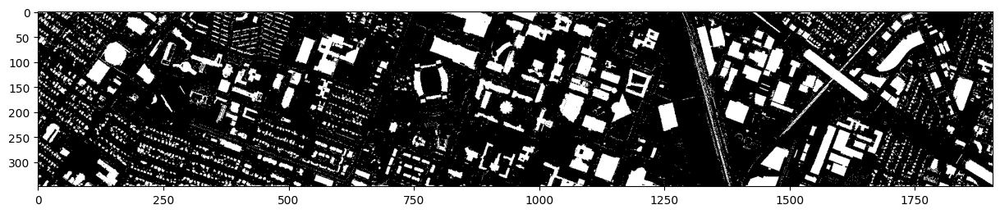

In [110]:
mask_buildings = (img_pred_1_4 == Classes.UNKNOWN) & (lidar > 10)
display_mask(mask_buildings)

In [111]:
classes_buildings = [Classes.RESIDENTIAL, Classes.COMMERCIAL]
clf_buildings_model = RandomForestClassifier(
    criterion="entropy",
    n_estimators=128,
    random_state=42,
    n_jobs=4,
)
clf_buildings = Classifier(classes_buildings, clf_buildings_model)

In [112]:
features_img_buildings = np.dstack((lidar, lbp_lidar, quot, mbf_lidar, ndmi))
features_amount = features_img_buildings.shape[-1]
features_buildings = features_img_buildings[mask_known]
features_buildings = features_buildings.reshape(-1, features_amount)
dataset_buildings = clf_buildings._dataset_get(
    features_buildings, y, include_unknown=True
)
features_buildings.shape

(2832, 39)

In [113]:
clf_buildings.fit(*dataset_buildings[:2])
clf_buildings.score(*dataset_buildings[2:])

0.9964726631393298

In [114]:
# Uncomment this block of code to reproduce

# clf_buildings.optimize(
#     features_buildings,
#     y,
#     include_unknown=True,
#     model_params=dict(
#         bootstrap=[True, False],
#         max_depth=[16, None],
#         max_features=["auto", "sqrt"],
#         min_samples_leaf=[1, 2],
#         min_samples_split=[2, 5],
#         n_estimators=[128, 256],
#         random_state=(0, 42),
#     ),
#     n_jobs=16,
#     verbose=1,
# )

Fitting 5 folds for each of 128 candidates, totalling 640 fits


/home/ucin/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
320 fits failed out of a total of 640.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
183 fits failed with the following error:
Traceback (most recent call last):
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/pipeline.py", line 475, in fit
    self._

1.0

In [115]:
model_save(clf_buildings, "classifier_buildings")

In [116]:
mask_buildings = (img_pred_1_4 == Classes.UNKNOWN) & (lidar > 10)
features_buildings_to_predict = features_img_buildings[mask_buildings]
y_pred_buildings = clf_buildings.predict(features_buildings_to_predict)
img_pred_buildings = np.zeros(features_img_buildings.shape[:2])
img_pred_buildings[mask_buildings] = y_pred_buildings

# post processing
labeled = label(mask_buildings)
regions = regionprops(labeled)

for region in regions:
    if region.area >= 4 and region.area < 128:
        for yy, xx in region.coords:
            if img_pred_buildings[yy, xx] == Classes.UNKNOWN:
                img_pred_buildings[yy, xx] = Classes.RESIDENTIAL

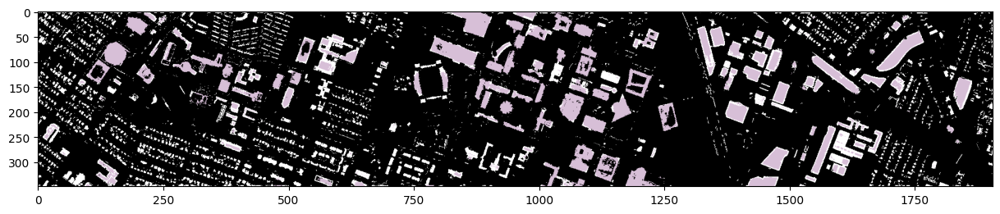

In [117]:
display_prediction(img_pred_buildings)

In [118]:
img_pred_1_5 = img_pred_1_4.copy()
mask_img_pred_buildings = img_pred_buildings != Classes.UNKNOWN
img_pred_1_5[mask_img_pred_buildings] = img_pred_buildings[mask_img_pred_buildings]

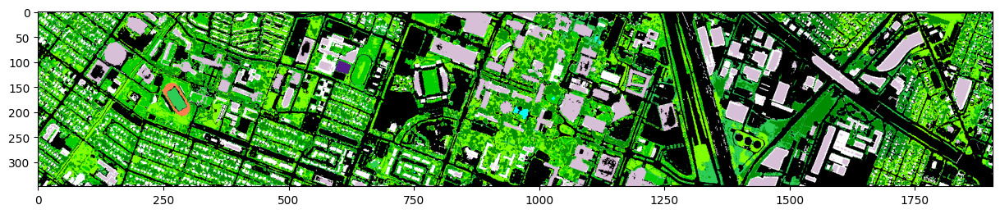

In [119]:
display_prediction(img_pred_1_5)

### 6. Discriminate and classify parking lots

In [120]:
classes_parkings = [Classes.PARKING_LOT1, Classes.PARKING_LOT2]
clf_parkings_model = RandomForestClassifier(
    criterion="gini",
    n_estimators=1024,
    max_depth=16,
    min_samples_leaf=1,
    min_samples_split=2,
    random_state=42,
    n_jobs=4,
)
clf_parkings = Classifier(classes_parkings, clf_parkings_model)

In [121]:
features_img_parkings = np.dstack((lidar, lbp_lidar, quot, mbf_lidar, hsi_raw))
features_amount = features_img_parkings.shape[-1]
features_parkings = features_img_parkings[mask_known]
features_parkings = features_parkings.reshape(-1, features_amount)
dataset_parkings = clf_parkings._dataset_get(
    features_parkings, y, include_unknown=True
)
features_parkings.shape

(2832, 182)

In [122]:
clf_parkings.fit(*dataset_parkings[:2])
clf_parkings.score(*dataset_parkings[2:])

0.9841269841269841

In [123]:
# Uncomment this block of code to reproduce

# clf_parkings.optimize(
#     features_parkings,
#     y,
#     include_unknown=True,
#     model_params=dict(
#         bootstrap=[True, False],
#         max_depth=[16, None],
#         max_features=["auto", "sqrt"],
#         min_samples_leaf=[1, 2, 4],
#         min_samples_split=[2, 5, 10],
#         n_estimators=[128, 256, 512],
#         random_state=(0, 42),
#     ),
#     n_jobs=16,
#     verbose=1,
# )

Fitting 5 folds for each of 432 candidates, totalling 2160 fits


/home/ucin/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
1080 fits failed out of a total of 2160.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
543 fits failed with the following error:
Traceback (most recent call last):
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/ucin/.local/lib/python3.11/site-packages/sklearn/pipeline.py", line 475, in fit
    self

0.9876543209876543

Slightly better.

In [124]:
model_save(clf_parkings, "classifier_parkings")

In [125]:
mask_free_1_5 = img_pred_1_5 == Classes.UNKNOWN
features_parkings_to_predict = features_img_parkings[mask_free_1_5]
y_pred_parkings = clf_parkings.predict(features_parkings_to_predict)
img_pred_parkings = np.zeros(features_img_parkings.shape[:2])
img_pred_parkings[mask_free_1_5] = y_pred_parkings

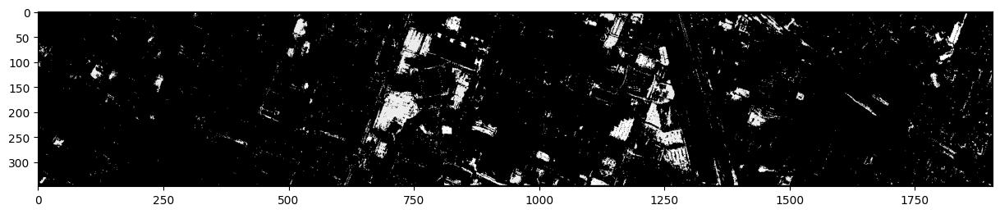

In [126]:
display_mask(img_pred_parkings)

In [127]:
img_pred_1_6 = img_pred_1_5.copy()
mask_img_pred_parkings = img_pred_parkings != Classes.UNKNOWN
img_pred_1_6[mask_img_pred_parkings] = img_pred_parkings[mask_img_pred_parkings]

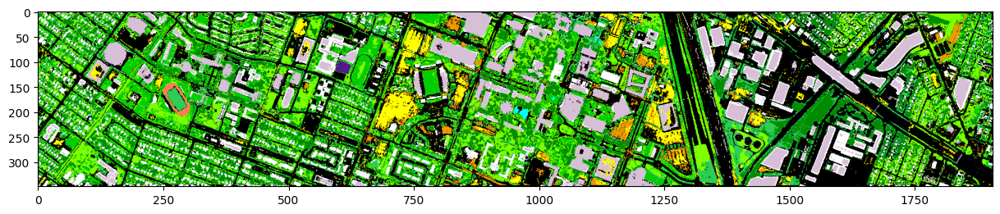

In [128]:
display_prediction(img_pred_1_6)

### 7. Discriminate soil

In [129]:
classes_soil = [Classes.SOIL]
clf_soil_model = RandomForestClassifier(
    criterion="entropy",
    random_state=42,
    n_jobs=4,
)
clf_soil = Classifier(classes_soil, clf_soil_model)

In [130]:
features_img_soil = np.dstack((evi, mcari, mtvi, ndmi, ndvi, osavi, pri, sr))
features_amount = features_img_soil.shape[-1]
features_soil = features_img_soil[mask_known]
features_soil = features_soil.reshape(-1, features_amount)
dataset_soil = clf_soil._dataset_get(features_soil, y, include_unknown=True)
features_soil.shape

(2832, 8)

In [131]:
clf_soil.fit(*dataset_soil[:2])
clf_soil.score(*dataset_soil[2:])

0.9964726631393298

In [132]:
model_save(clf_soil, "classifier_soil")

In [133]:
mask_free_1_6 = img_pred_1_6 == Classes.UNKNOWN
features_soil_to_predict = features_img_soil[mask_free_1_6]
y_pred_soil = clf_soil.predict(features_soil_to_predict)
img_pred_soil = np.zeros(features_img_soil.shape[:2])
img_pred_soil[mask_free_1_6] = y_pred_soil

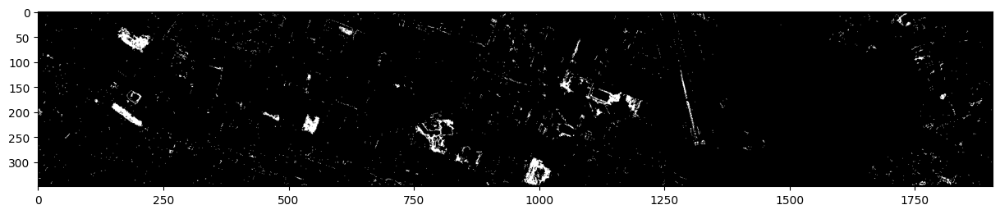

In [134]:
display_mask(img_pred_soil)

In [135]:
img_pred_1_7 = img_pred_1_6.copy()
mask_img_pred_soil = img_pred_soil != Classes.UNKNOWN
img_pred_1_7[mask_img_pred_soil] = img_pred_soil[mask_img_pred_soil]

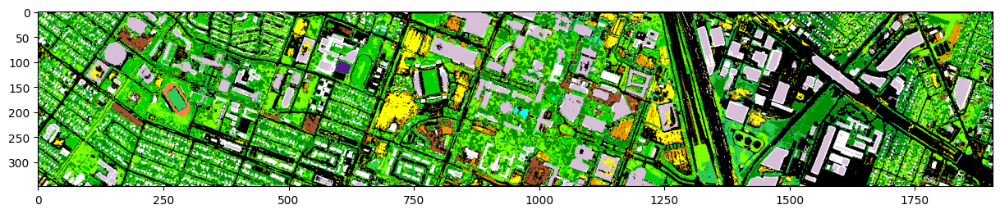

In [136]:
display_prediction(img_pred_1_7)

### 8. Discriminate and classify highway, railway, road

In [137]:
classes_streets = [Classes.HIGHWAY, Classes.RAILWAY, Classes.ROAD]
clf_streets_model = RandomForestClassifier(
    criterion="entropy",
    random_state=42,
    n_jobs=4,
)
clf_streets = Classifier(classes_streets, clf_streets_model)

In [138]:
features_img_streets = np.dstack((lidar, lbp_lidar, mbf_lidar, hsi_raw, osavi, ndvi))
features_amount = features_img_streets.shape[-1]
features_streets = features_img_streets[mask_known]
features_streets = features_streets.reshape(-1, features_amount)
dataset_streets = clf_streets._dataset_get(features_streets, y, include_unknown=True)
features_streets.shape

(2832, 172)

Using osavi and ndvi indexes here because they are less influenced by the shadow.

In [139]:
clf_streets.fit(*dataset_streets[:2])
clf_streets.score(*dataset_streets[2:])

0.9929453262786596

In [140]:
model_save(clf_streets, "classifier_streets")

In [141]:
mask_free_1_7 = img_pred_1_7 == Classes.UNKNOWN
features_streets_to_predict = features_img_streets[mask_free_1_7]
y_pred_streets = clf_streets.predict(features_streets_to_predict)
img_pred_streets = np.zeros(features_img_streets.shape[:2])
img_pred_streets[mask_free_1_7] = y_pred_streets

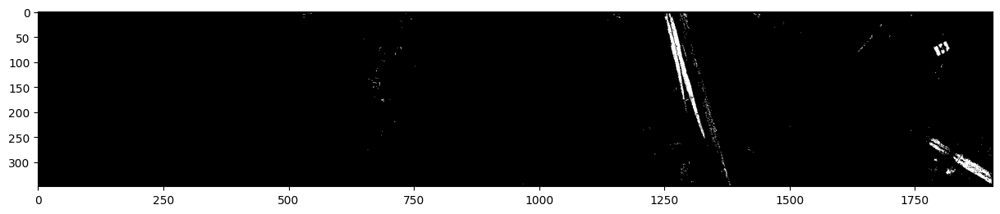

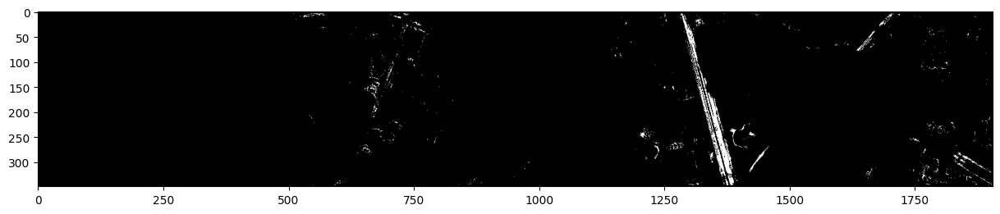

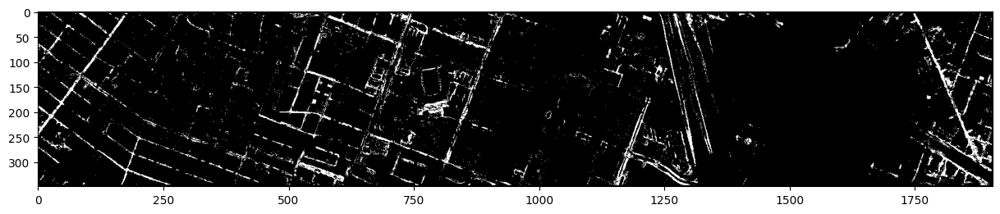

In [142]:
display_mask(img_pred_streets == Classes.HIGHWAY)
display_mask(img_pred_streets == Classes.RAILWAY)
display_mask(img_pred_streets == Classes.ROAD)

Nevertheless, the problem in the shadow persists. The highway isn't properly detected.

In [143]:
img_pred_1_8 = img_pred_1_7.copy()
mask_img_pred_streets = img_pred_streets != Classes.UNKNOWN
img_pred_1_8[mask_img_pred_streets] = img_pred_streets[mask_img_pred_streets]

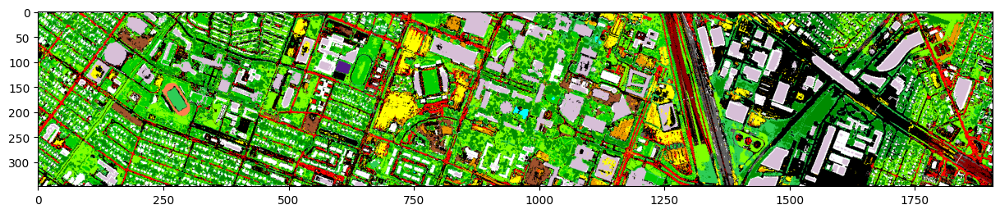

In [144]:
display_prediction(img_pred_1_8)

### 9. Normalize

The idea here is to classify remaining pixels using data from previous steps, assuming a part of the predictions made before are correct.

In [145]:
classes_completion = [
    Classes.SOIL,
    Classes.ROAD,
    Classes.HIGHWAY,
    Classes.RAILWAY,
    Classes.RESIDENTIAL,
    Classes.COMMERCIAL,
]
clf_completion_model = RandomForestClassifier(
    criterion="entropy",
    random_state=42,
    n_estimators=128,
    n_jobs=4,
)
clf_completion = Classifier(classes_completion, clf_completion_model)

In [146]:
features_img_completion = np.dstack((lidar, mbf_lidar, quot))
features_amount = features_img_completion.shape[-1]
mask_known_1_8 = img_pred_1_8 != Classes.UNKNOWN
features_completion = features_img_completion[
    (mask_known_1_8) | (groundtruth != Classes.UNKNOWN)
]
features_completion = features_completion.reshape(-1, features_amount)
y_completion = img_pred_1_8.copy()
y_completion[groundtruth != Classes.UNKNOWN] = groundtruth[groundtruth != Classes.UNKNOWN]
y_completion = y_completion[y_completion != Classes.UNKNOWN].reshape(-1)
dataset_completion = clf_completion._dataset_get(
    features_completion, y_completion, include_unknown=False
)
features_completion.shape

(506362, 37)

In [147]:
clf_completion.fit(*dataset_completion[:2])
clf_completion.score(*dataset_completion[2:])

0.9768834658009627

As we are training here on a part of the data predicted before, an optimization of hyper parameters may not be the best thing to do.

In [148]:
model_save(clf_completion, "classifier_completion")

In [149]:
mask_free_1_8 = img_pred_1_8 == Classes.UNKNOWN
features_completion_to_predict = features_img_completion[mask_free_1_8]
y_pred_completion = clf_completion.predict(features_completion_to_predict)
img_pred_1_9 = img_pred_1_8.copy()
img_pred_1_9[mask_free_1_8] = y_pred_completion

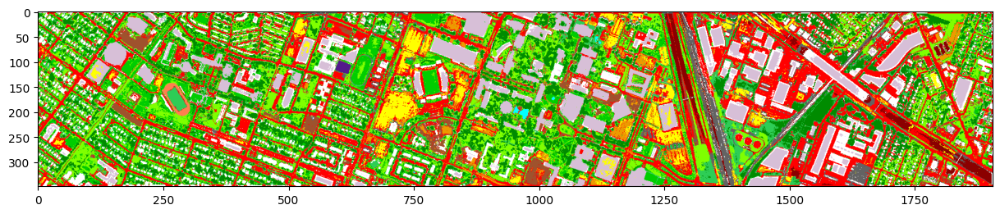

In [150]:
display_prediction(img_pred_1_9)

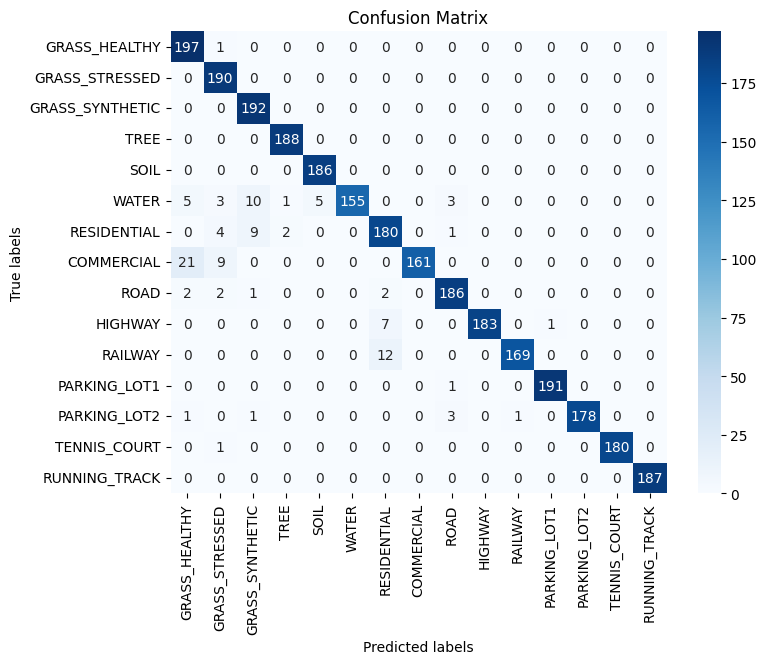

In [151]:
display_confusion_matrix(groundtruth[mask_known], img_pred_1_9[mask_known])

### Unify the code under a function

In [152]:
def solution(hsi, lidar):
    img_pred = np.zeros(lidar.shape)

    # compute features
    evi = SpectralIndices.evi(hsi)
    mcari = SpectralIndices.mcari(hsi)
    mtvi = SpectralIndices.mtvi(hsi)
    ndmi = SpectralIndices.ndmi(hsi)
    ndvi = SpectralIndices.ndvi(hsi)
    ndwi = SpectralIndices.ndwi(hsi)
    osavi = SpectralIndices.osavi(hsi)
    pri = SpectralIndices.pri(hsi)
    sr = SpectralIndices.sr(hsi)
    quot = SpectralIndices.quot(hsi)
    lbp_lidar = local_binary_pattern(lidar, 24, 3)
    mbf_lidar = multiscale_basic_features(lidar).reshape((*lidar.shape, -1))

    # preprocess lidar
    lidar = lidar - compute_ground_height(lidar)

    # load models
    disc_vegetation = model_load("discriminator_vegetation")
    clf_vegetation = model_load("classifier_vegetation")
    disc_running_track = model_load("discriminator_running_track")
    disc_tennis_court = model_load("discriminator_tennis_court")
    disc_water = model_load("discriminator_water")
    clf_buildings = model_load("classifier_buildings")
    clf_parkings = model_load("classifier_parkings")
    clf_soil = model_load("classifier_soil")
    clf_streets = model_load("classifier_streets")
    clf_completion = model_load("classifier_completion")

    # step 1
    features_img = np.dstack((hsi, lidar, ndvi, osavi, ndwi))
    mask = disc_vegetation.predict(hsi, features_img)
    X = features_img[mask]
    y_pred = clf_vegetation.predict(X)
    img_pred[mask] = y_pred

    # step 2
    features_img = np.dstack((hsi, lidar))
    y_pred = disc_running_track.predict_with_postprocessing(features_img)
    mask = y_pred.reshape(img_pred.shape) != Classes.UNKNOWN
    img_pred[mask] = Classes.RUNNING_TRACK

    # step 3
    features_img = np.dstack((hsi, lidar))
    y_pred = disc_tennis_court.predict_with_postprocessing(features_img)
    mask = y_pred.reshape(img_pred.shape) != Classes.UNKNOWN
    img_pred[mask] = Classes.TENNIS_COURT

    # step 4
    features_img = np.dstack((hsi, lidar, ndwi))
    mask = disc_water.predict(hsi, features_img) != Classes.UNKNOWN
    img_pred[mask] = Classes.WATER

    # step 5
    mask = (img_pred == Classes.UNKNOWN) & (lidar > 10)
    features_img = np.dstack((lidar, lbp_lidar, quot, mbf_lidar, ndmi))
    X = features_img[mask]
    y_pred = clf_buildings.predict(X)
    img_pred_bis = np.zeros(img_pred.shape)
    img_pred_bis[mask] = y_pred
    labeled = label(mask)
    regions = regionprops(labeled)
    for region in regions:
        if region.area >= 4 and region.area < 128:
            for yy, xx in region.coords:
                if img_pred_bis[yy, xx] == Classes.UNKNOWN:
                    img_pred_bis[yy, xx] = Classes.RESIDENTIAL
    mask = img_pred_bis != Classes.UNKNOWN
    img_pred[mask] = img_pred_bis[mask]

    # step 6
    features_img = np.dstack((lidar, lbp_lidar, quot, mbf_lidar, hsi))
    mask = img_pred == Classes.UNKNOWN
    X = features_img[mask]
    y_pred = clf_parkings.predict(X)
    img_pred_bis = np.zeros(img_pred.shape)
    img_pred_bis[mask] = y_pred
    mask = img_pred_bis != Classes.UNKNOWN
    img_pred[mask] = img_pred_bis[mask]

    # step 7
    features_img = np.dstack((evi, mcari, mtvi, ndmi, ndvi, osavi, pri, sr))
    mask = img_pred == Classes.UNKNOWN
    X = features_img[mask]
    y_pred = clf_soil.predict(X)
    img_pred_bis = np.zeros(img_pred.shape)
    img_pred_bis[mask] = y_pred
    mask = img_pred_bis != Classes.UNKNOWN
    img_pred[mask] = img_pred_bis[mask]

    # step 8
    features_img = np.dstack((lidar, lbp_lidar, mbf_lidar, hsi, osavi, ndvi))
    mask = img_pred == Classes.UNKNOWN
    X = features_img[mask]
    y_pred = clf_streets.predict(X)
    img_pred_bis = np.zeros(img_pred.shape)
    img_pred_bis[mask] = y_pred
    mask = img_pred_bis != Classes.UNKNOWN
    img_pred[mask] = img_pred_bis[mask]

    # step 9
    features_img = np.dstack((lidar, mbf_lidar, quot))
    mask = img_pred == Classes.UNKNOWN
    X = features_img[mask]
    y_pred = clf_completion.predict(X)
    img_pred[mask] = y_pred

    return img_pred.astype(np.uint8)

In [153]:
predictions = solution(hsi_raw, lidar)

/home/ucin/.local/lib/python3.11/site-packages/skimage/feature/texture.py:353: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


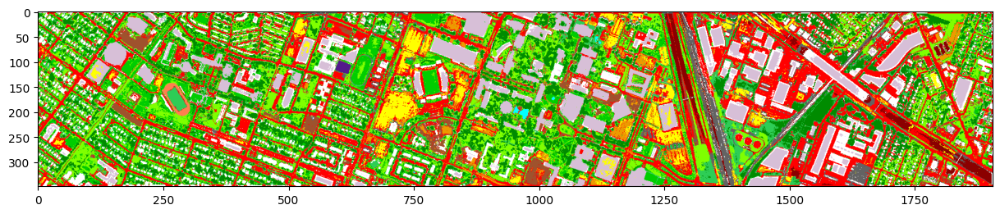

In [154]:
display_prediction(predictions)

In [155]:
np.all(predictions == img_pred_1_9)

True

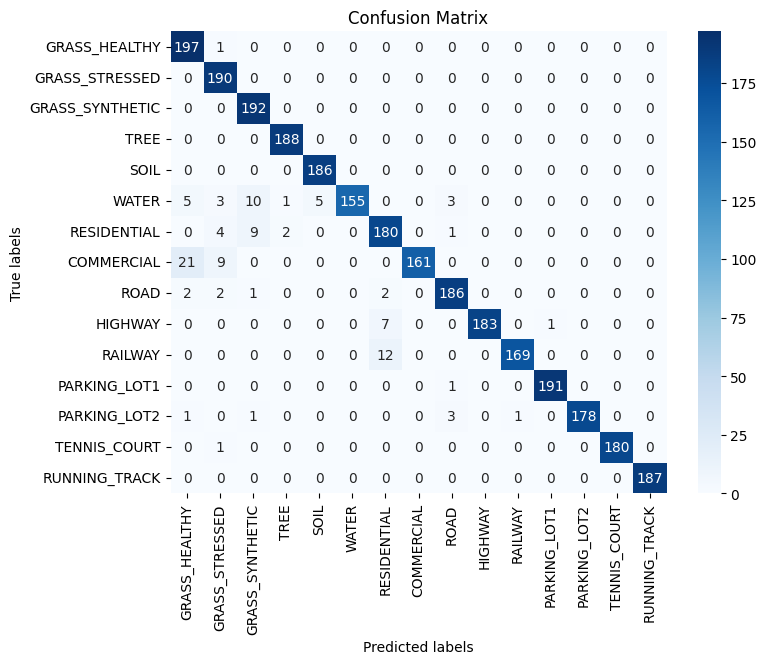

In [156]:
display_confusion_matrix(groundtruth[mask_known], predictions[mask_known])

# Save Results

In [157]:
export_predictions(predictions, "predictions")

Prédictions exportées dans predictions.npz, n'oubliez pas d'envoyer votre fichier !


Évaluation de predictions.npz:
Mean accuracy (micro, no background): 0.96
Mean accuracy (macro, no background): 0.06


/tmp/ipykernel_94647/3770553655.py:30: RuntimeWarning: invalid value encountered in divide
  class_accuracy = np.diag(confusion_matrix) / np.sum(confusion_matrix, axis=1)


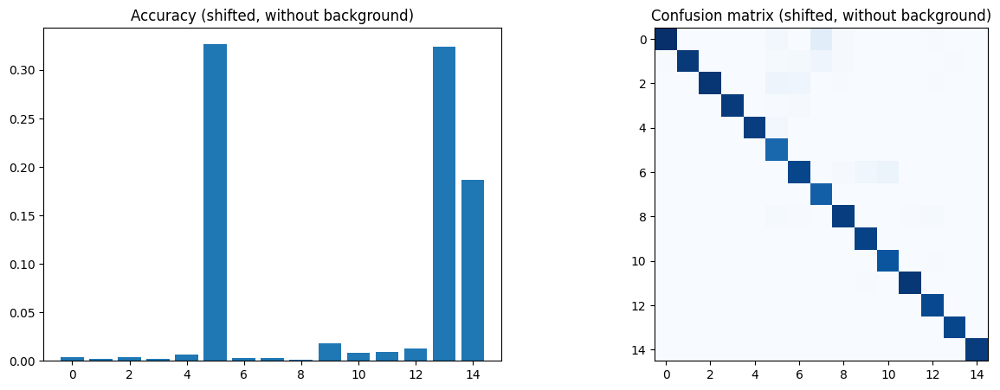

In [158]:
file = "predictions.npz"
print(f"Évaluation de {file}:")
accuracy, class_accuracy, accuracy_no_unclassified_micro, cmat = (
    load_eval_perf(file, groundtruth)
)
print(f"Mean accuracy (micro, no background): {accuracy_no_unclassified_micro:.2f}")
accuracy_no_unclassified_macro = np.mean(class_accuracy[1:])
print(f"Mean accuracy (macro, no background): {accuracy_no_unclassified_macro:.2f}")
# Display results
plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.title("Accuracy (shifted, without background)")
plt.bar(range(15), class_accuracy[1:])
plt.xlim(-1, 15)
plt.subplot(122)
plt.title("Confusion matrix (shifted, without background)")
plt.imshow(cmat[1:, 1:], cmap="Blues")
plt.show()